## Configuración inicial

A continuación se importan las librerías necesarias para el funcionamiento del notebook.

In [1]:
#plots and data
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

#metrics and transformations
from sklearn.preprocessing import MinMaxScaler,StandardScaler
from sklearn.metrics import mean_squared_error
from sklearn import metrics

#Model 
from sklearn.neural_network import MLPRegressor
sns.set()

In [3]:
def plot_predict_test(df_test_y,testPredict,lag):
        ### Resultado predicción datos de entrenamiento
    print(testPredict.flatten())
    fig, ax = plt.subplots(figsize=[15,8])
    sns.lineplot(df_test_y.flatten(),label="real")
    sns.lineplot(testPredict.flatten(),label="predicción")
    plt.title("Comparación valor real y predicción")
    plt.ylabel("value")

In [4]:
def createLagFeature(name_features,lag,df):
    for name_feature in name_features:
        for i in range(1,lag+1):
            df[name_feature+"lag"+str(i)]=df[name_feature].shift(i)
    return df

In [5]:
#function to measure the performance
def timeseries_evaluation_metrics_func(y_true, y_pred,flag):
    def mean_absolute_percentage_error(y_true, y_pred): 
        epsilon=0.1e-5
        y_true, y_pred = np.array(y_true), np.array(y_pred)
        return np.mean(np.abs((y_true - y_pred) / y_true)) * 100
    
    if flag : print(f'R2 is : {metrics.r2_score(y_true, y_pred)}',end='\n\n')
    else:
        print('Evaluation metric results:')
        print(f'MSE is : {metrics.mean_squared_error(y_true, y_pred)}')
        print(f'MAE is : {metrics.mean_absolute_error(y_true, y_pred)}')
        print(f'RMSE is : {np.sqrt(metrics.mean_squared_error(y_true, y_pred))}')
        print(f'MAPE is : {mean_absolute_percentage_error(y_true, y_pred)}')
        
    return {"MSE":metrics.mean_squared_error(y_true, y_pred),
           "MAE":metrics.mean_absolute_error(y_true, y_pred),
           "RMSE":np.sqrt(metrics.mean_squared_error(y_true, y_pred)),
           "MAPE":mean_absolute_percentage_error(y_true, y_pred)}

---

## Cargar y preparar los datos.

In [2]:
df = pd.read_csv("../../Datasets/Datos_durante_pandemia/data_durante_vol_ve_in_ic.csv")

df['Fecha'] = pd.to_datetime(df['Fecha'])
df = df.sort_values('Fecha', ascending=True)
df = df.rename(columns = {'Vol. Futuros': 'VolFuturos'})
df

,Fecha,VolFuturos,TRM,Precio Interno,VIX,EMV-ID,EPU,PI,MHI,FNI,SI
0,2020-01-01,1.289946,3277.14,975000.0,12.548403,1.89,186.06,0.00,0.00,0.00,0.00
1,2020-01-02,0.735046,3277.14,945000.0,12.470000,2.84,139.13,0.00,0.00,0.00,0.00
2,2020-01-03,0.591834,3258.84,940000.0,14.020000,1.33,108.10,0.00,0.00,0.00,0.00
3,2020-01-04,1.367154,3262.05,930000.0,14.646666,0.00,212.82,0.00,0.00,0.00,0.00
4,2020-01-05,1.505321,3262.05,920000.0,14.311970,0.86,173.76,0.00,0.00,0.00,0.00
...,...,...,...,...,...,...,...,...,...,...,...
913,2022-07-02,0.778572,4198.77,2270000.0,25.922916,11.11,130.95,4.66,25.71,0.19,-3.56
914,2022-07-03,0.819483,4198.77,2270000.0,26.641413,23.06,135.95,0.42,7.76,0.00,-3.67
915,2022-07-04,0.843804,4198.77,2270000.0,27.530000,15.98,309.83,0.54,31.37,0.27,-5.85
916,2022-07-05,0.850985,4198.77,2280000.0,27.540000,18.90,116.59,0.48,38.21,0.12,-4.97


---

## Desarrollo del modelo

In [7]:
#objects to scale the data 
sc=StandardScaler()
sc2=StandardScaler()

In [8]:
df_stats=df

In [9]:
#
len_data=df_stats.shape[0]

#get target
df_label=df_stats["VolFuturos"].values.reshape(len_data,1)
#get attributes
df_data=df_stats.drop(columns=["Fecha"])

#apply scale
#df_label=sc.fit_transform(df_label)
#df_data_normalize=sc2.fit_transform(df_data)


In [10]:
def Model(df_data,df_label,lag,estimators):
    delete_columns=list(df_data.columns)
    df_data_lags=createLagFeature(df_data.columns,lag,df_data) if lag>0 else df_data
    
    df_data_lags.drop(columns=delete_columns,inplace=True)
    df_data_lags=df_data_lags[lag:]
    df_label=df_label[lag:]

    #transform data
    df_data_lags=sc2.fit_transform(df_data_lags)
    
    #split data
    #last index of the train data
    seventy_percent=int(len_data*0.7)

    #split the data normalize
    
    df_train=df_data_lags[:seventy_percent]
    df_test=df_data_lags[seventy_percent:]

    #split labels
    
    df_train_y=df_label[:seventy_percent]
    df_test_y=df_label[seventy_percent:]
    #split labels normalize
    
    df_label_normalize=sc.fit_transform(df_label)
    df_train_y_normalize=df_label_normalize[:seventy_percent]
    df_test_y_normalize=df_label_normalize[seventy_percent:]
    


    #make model
    model=MLPRegressor(hidden_layer_sizes=(estimators,), activation='logistic', solver='adam')
    #fit the model with the train data
    history=model.fit(df_train,df_train_y_normalize)
   
    # make predictions
    trainPredict = model.predict(df_train)
    trainPredict = np.reshape(trainPredict,(len(trainPredict),1))
    # invert transformation
    trainPredict = sc.inverse_transform(trainPredict)
    
    trainY = df_train_y
    
    # make predictions
    testPredict = model.predict(df_test)
    # invert transformation
    testPredict = np.reshape(testPredict,(len(testPredict),1))
    testPredict = sc.inverse_transform(testPredict)
    testY = df_test_y
    print("len test: ",testY.shape)
    print("len PREDICT: ",testPredict.shape)

    plot_predict_test(df_train_y,trainPredict,lag)
    plot_predict_test(df_test_y,testPredict,lag)
    return [{"Fecha":df_stats.Fecha[lag:][:seventy_percent],"typeELM":["train"]*len(trainPredict.flatten()),"ELM" :trainPredict.flatten()}
            ,{"Fecha":df_stats.Fecha[lag:][seventy_percent:],"typeELM":["test"]*len(testPredict.flatten()),"ELM":testPredict.flatten()}]
    
    return {"train":timeseries_evaluation_metrics_func(trainY.flatten()+1, trainPredict.flatten()+1,False),
           "test":timeseries_evaluation_metrics_func(testY.flatten()+1, testPredict.flatten()+1,False)}

## Resultados

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (273, 1)
len PREDICT:  (273, 1)
[1.14621757 1.1412975  1.13403977 1.09864884 1.05633238 1.4003257
 1.10945591 1.39378548 1.02222069 1.28261528 1.10332558 1.10929662
 1.05508849 1.0394681  0.984165   0.98196141 0.86358594 0.86153266
 0.90387716 0.821379   1.09743942 1.19744642 1.34108124 1.20765572
 1.22376927 1.21992388 1.46071925 1.14470395 1.39565798 1.15078298
 1.60351996 1.35987624 1.23712483 1.17399526 0.93001616 0.85852807
 0.93878091 0.97868957 0.95596835 0.88857926 0.91478728 1.57219451
 1.69864619 1.5050721  1.52743647 1.33209507 1.15640751 1.05325016
 1.43065141 1.83257171 1.61444264 1.96463597 1.63331404 1.50306144
 1.84594055 1.63377939 1.77246558 1.62703734 2.02178529 2.27653479
 2.30359889 2.18629866 2.43876598 2.25076339 2.19559962 1.6785326
 1.93828076 2.22757836 2.39021991 2.42099343 2.12035974 1.94359254
 1.64308276 2.04916478 2.34987299 2.41027502 2.44952817 2.29194019
 2.3086035  2.03779706 2.06703183 2.35403301 2.29766596 2.41773575
 2.48207442 2.3309634

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[1.16860756 1.24228596 1.17400831 1.08701055 1.08165935 1.50313545
 1.03690611 1.38469289 1.0153675  1.36935132 1.05663916 1.06187633
 1.07382349 1.05329575 0.93754073 0.94800383 0.84671587 0.8191
 0.87781866 0.75246876 1.12793603 1.14098466 1.25257625 1.13776464
 1.17912062 1.24147179 1.42235178 0.99802857 1.35007228 1.05837625
 1.57000611 1.23927515 1.10274034 1.1137973  0.86845609 0.80862759
 0.87851274 0.92962605 0.87005203 0.78849665 0.84106754 1.58830891
 1.57743854 1.29232122 1.48930563 1.30109838 1.08175725 0.99908218
 1.4894568  1.80438685 1.42241358 2.00568388 1.56401714 1.42973077
 1.84121204 1.56731856 1.82562071 1.63800806 2.12415929 2.65676619
 2.63440741 2.27061473 3.038635   2.27650944 2.24558479 1.65261637
 2.08224344 2.42749946 2.69687567 2.84169768 2.20242738 1.88532578
 1.48885091 2.01695899 2.9421639  3.15000577 3.03228428 2.41228795
 2.42291259 2.06556348 2.03133421 2.68268211 2.51516068 2.97998947
 3.23899217 2.40069425 

Evaluation metric results:
MSE is : 1.4243596328881767
MAE is : 0.8532125939302238
RMSE is : 1.1934653882237962
MAPE is : 40.80453462801808
Evaluation metric results:
MSE is : 1.5714721629309993
MAE is : 1.0540489321212865
RMSE is : 1.253583727930049
MAPE is : 60.20001069803781


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (273, 1)
len PREDICT:  (273, 1)
[1.21685178 1.29434442 1.19916961 1.11530347 1.12361421 1.58261155
 1.06372984 1.45110207 1.05622108 1.44045441 1.07987254 1.09889954
 1.12302773 1.10228907 0.97566229 0.99043704 0.88967951 0.83899685
 0.92212306 0.77889182 1.19524933 1.19246097 1.31174544 1.18673776
 1.20247358 1.30221831 1.50908889 1.00112292 1.41563014 1.07316281
 1.60670121 1.24715683 1.13147259 1.14929677 0.89648926 0.82784215
 0.8946523  0.95235082 0.89006384 0.79886237 0.83658144 1.68892546
 1.60741609 1.34170624 1.58756143 1.34313808 1.10371897 1.04256753
 1.58738498 1.88594608 1.45538198 2.09500675 1.58968594 1.44042769
 1.87834361 1.61286263 1.82106433 1.59973307 2.18977666 2.75817814
 2.73011119 2.27040623 3.29099447 2.30622746 2.29024564 1.69844811
 2.13157878 2.42929927 2.78093715 2.84942105 2.00653639 1.89765842
 1.45691785 1.91376553 2.82174758 3.27483319 2.94078288 2.12364206
 2.04125983 1.86865194 1.99906962 2.66611042 2.42250194 2.95275653
 3.29777458 2.15994

Evaluation metric results:
MSE is : 1.4118417378538548
MAE is : 0.8537772223438163
RMSE is : 1.1882094671621897
MAPE is : 41.02582370631564
Evaluation metric results:
MSE is : 1.6095738457481035
MAE is : 1.0674478107864793
RMSE is : 1.268689814630867
MAPE is : 61.174149141715404


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[1.18361867 1.29521449 1.2372693  1.1076447  1.07979832 1.56800244
 1.08673754 1.40873898 1.03250614 1.42943513 1.10261362 1.0586173
 1.07609138 1.06590127 0.94596515 0.94083756 0.85346752 0.8093147
 0.86800256 0.73773697 1.14053161 1.17710271 1.30447681 1.17088135
 1.15501214 1.24919929 1.5009829  1.01140431 1.34981036 1.0598737
 1.59996985 1.2690459  1.0869245  1.08799376 0.85202306 0.7951145
 0.85986343 0.92898276 0.85776091 0.77328388 0.80843466 1.65649128
 1.68004332 1.33658353 1.52974563 1.33312949 1.08214824 0.9757417
 1.57411503 1.96345528 1.50228182 2.08399132 1.60585169 1.4367546
 1.84274183 1.60114701 1.80224733 1.57305152 2.09095197 2.72526025
 2.78380312 2.367194   3.28822314 2.43041837 2.31083047 1.67620184
 2.17574256 2.52648656 2.76832972 2.86642593 2.12428006 1.90752188
 1.57053832 2.04172605 3.04992005 3.3421275  3.09502756 2.33677783
 2.22092482 2.04827244 2.16604329 2.79610123 2.61623662 3.09787235
 3.41943794 2.35120778 2.

Evaluation metric results:
MSE is : 1.411428515764569
MAE is : 0.8531509273765234
RMSE is : 1.1880355700754792
MAPE is : 40.92704456696185
Evaluation metric results:
MSE is : 1.588176437673018
MAE is : 1.058968474507497
RMSE is : 1.2602287243484882
MAPE is : 60.37717708541337


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[1.19024437 1.28754685 1.2226808  1.1020104  1.08929754 1.54865859
 1.07148404 1.38276927 1.02728787 1.40120232 1.08966546 1.05659199
 1.07956737 1.08134992 0.95909035 0.95599832 0.87235829 0.84368614
 0.90272266 0.77745032 1.16129135 1.20515359 1.3005586  1.17330344
 1.18503931 1.26544104 1.49591251 1.0041415  1.35448674 1.09398265
 1.60462985 1.2671276  1.08435869 1.10070702 0.88121576 0.8311679
 0.90343113 0.95720838 0.89375778 0.81871288 0.84214173 1.66170488
 1.66140281 1.29646212 1.49160454 1.33713149 1.08805362 1.02563956
 1.56251033 1.93266445 1.47105692 2.0508551  1.63449223 1.47126218
 1.86468713 1.68338968 1.82533571 1.54776787 2.05774422 2.72752561
 2.7848881  2.29253062 3.24080565 2.40474132 2.26719756 1.63450399
 2.10707033 2.41417262 2.67983252 2.91376274 2.07169466 1.87770223
 1.57853477 2.13755499 3.02929804 3.34844542 3.08514203 2.27239628
 2.20555968 1.95922148 2.06069518 2.79552918 2.57559875 2.97802959
 3.31644596 2.268793

Evaluation metric results:
MSE is : 1.4198041294009045
MAE is : 0.855157193863189
RMSE is : 1.191555340469298
MAPE is : 41.06758172933921
Evaluation metric results:
MSE is : 1.6708348262165504
MAE is : 1.0886159007612353
RMSE is : 1.2926077619357508
MAPE is : 63.04144546804342


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[1.28870314 1.37178084 1.29802534 1.20104182 1.19396812 1.6512867
 1.16580338 1.48494669 1.12497536 1.49192255 1.18779111 1.1664946
 1.19041729 1.18784584 1.06071993 1.05959904 0.96615378 0.9417398
 1.0122584  0.87377783 1.25730292 1.29515274 1.37735996 1.2367415
 1.2661681  1.36636728 1.55782454 1.09181928 1.44971179 1.15804782
 1.65804667 1.33861701 1.16563967 1.20730486 0.98050144 0.9145593
 0.97170968 1.03396994 0.96678876 0.89106768 0.92354672 1.75521413
 1.72739202 1.36863892 1.57118858 1.40965528 1.16858739 1.10133921
 1.63770722 1.97482453 1.49707996 2.08354049 1.65352765 1.49186744
 1.84315249 1.62844636 1.79217242 1.54559502 2.01984845 2.6815267
 2.72674452 2.26154236 3.27094163 2.33373525 2.24027913 1.60686748
 2.08909922 2.39686289 2.63781096 2.89081154 2.00501209 1.75557349
 1.52912546 1.8415096  2.8598341  3.23625718 3.06870723 2.26343728
 2.24518845 1.96056298 2.00325629 2.72393001 2.55029851 2.94755579
 3.36543435 2.3300155  2.

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[1.22179832 1.32069676 1.25316184 1.14938057 1.12626492 1.57584848
 1.11887479 1.41443102 1.07314539 1.4340599  1.1402837  1.1097866
 1.12070629 1.1241342  1.00793452 0.99915898 0.91337183 0.87889237
 0.94758499 0.82061687 1.18735704 1.23962178 1.33407994 1.19443623
 1.19357064 1.29899088 1.50609904 1.04759529 1.37466581 1.12493315
 1.5991268  1.28603519 1.10867431 1.12784923 0.91126921 0.85774149
 0.92710235 0.98593227 0.91913808 0.86221812 0.86758871 1.66722358
 1.6687064  1.31859559 1.51787421 1.35988538 1.11126925 1.05294884
 1.58305864 1.91618758 1.45630832 2.00831921 1.59168106 1.44546176
 1.81594124 1.60058639 1.82618193 1.57782195 2.01706391 2.62223273
 2.67273343 2.19883502 3.15200737 2.28685085 2.18322197 1.62590599
 2.09937368 2.4417772  2.63786162 2.74178591 2.06746602 1.78946284
 1.53756883 2.05468733 2.82903885 3.10961212 3.0155229  2.20396985
 2.12139616 1.92897009 2.12716605 2.80684691 2.54745372 2.91348387
 3.28945854 2.244524

Evaluation metric results:
MSE is : 1.4268416531533474
MAE is : 0.8600196607456707
RMSE is : 1.1945047731814835
MAPE is : 41.684119864789984
Evaluation metric results:
MSE is : 1.5459343170729538
MAE is : 1.042348863672302
RMSE is : 1.2433560701074144
MAPE is : 59.449508985966084


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[1.15632358 1.23616161 1.18369426 1.07948152 1.06342974 1.51443602
 1.07848763 1.35631328 1.01144261 1.36016147 1.09175316 1.05419845
 1.06717133 1.08038904 0.96673817 0.95626446 0.86116539 0.84521798
 0.90946939 0.7897358  1.15151792 1.20450855 1.28731468 1.14105257
 1.17319922 1.26688426 1.47412899 1.02805305 1.34045572 1.1021812
 1.58655991 1.28853855 1.11093484 1.13558712 0.92377544 0.8577042
 0.9305504  0.98646186 0.93129421 0.84348807 0.8770042  1.64949131
 1.65435183 1.29079996 1.44595241 1.32222039 1.10545191 1.01518173
 1.54090854 1.88737595 1.41999098 1.9415796  1.57382093 1.41610619
 1.77869801 1.59009002 1.76343192 1.57504141 2.03545624 2.62764575
 2.68515894 2.21024058 3.15766862 2.30465917 2.1970493  1.60703864
 2.07921923 2.47255512 2.69320193 2.87509262 2.10660422 1.8946547
 1.66764245 2.2066376  3.0248022  3.25249753 3.16278654 2.45515129
 2.38627694 2.10103664 2.19684883 2.87995771 2.67257949 3.03962687
 3.45231138 2.44515483

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[1.15293992 1.2144559  1.16513015 1.0809507  1.06324301 1.48273902
 1.0523283  1.3684479  0.99866947 1.34624355 1.05893462 1.04993121
 1.05095128 1.0368555  0.9328222  0.93551471 0.83183351 0.80697806
 0.86506185 0.74396361 1.11353621 1.15935897 1.27223784 1.15122616
 1.17965027 1.24243163 1.46152192 1.01468982 1.33735455 1.06389026
 1.56148587 1.25469045 1.11866029 1.10759837 0.85949122 0.78692749
 0.86661066 0.9156242  0.87440958 0.79204327 0.83009463 1.60555285
 1.61241208 1.32424472 1.50018081 1.29871997 1.0776368  1.01261181
 1.50847782 1.8484718  1.44350177 2.00422701 1.56158221 1.4052128
 1.82687139 1.54427631 1.77554382 1.59807482 2.06870733 2.64003515
 2.67520591 2.28214563 3.25643598 2.33858801 2.30278455 1.67000541
 2.160195   2.48703794 2.81999105 2.96856271 2.22023563 2.02610977
 1.60472774 2.20445889 2.96103335 3.36122248 3.25418362 2.56157765
 2.51452963 2.0846539  2.2589886  2.87359557 2.6818455  3.1390124
 3.59623408 2.5273640

Evaluation metric results:
MSE is : 1.431288681225423
MAE is : 0.8668030639300693
RMSE is : 1.196364777659984
MAPE is : 42.36585527050859
Evaluation metric results:
MSE is : 1.6738333054256096
MAE is : 1.0909599428507266
RMSE is : 1.2937670986022212
MAPE is : 63.0828131483706


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[1.17599932 1.27884455 1.19296118 1.08451011 1.08229012 1.54424816
 1.04612061 1.36791625 1.02547272 1.39949985 1.07792245 1.05731387
 1.09091885 1.0888303  0.96205719 0.96656023 0.88593694 0.84924149
 0.91775418 0.78879407 1.17106677 1.19219477 1.27659778 1.14659584
 1.16566836 1.28355707 1.46544706 0.99064092 1.36291863 1.10057504
 1.58250941 1.25574238 1.09091146 1.13445917 0.91138954 0.8599206
 0.92731445 0.98799742 0.92318868 0.84798924 0.86952813 1.66797356
 1.59511375 1.24360908 1.48650579 1.31534249 1.08760982 1.0297483
 1.57884531 1.85541549 1.37181053 1.97508334 1.55304662 1.42676594
 1.78482512 1.58861203 1.81762148 1.60781588 2.06118528 2.69140521
 2.6924003  2.1764127  3.24265038 2.24828641 2.20056261 1.69498591
 2.20069305 2.48495315 2.70260778 2.97242428 2.17162717 1.92401854
 1.7529374  2.23021749 3.08815646 3.38978214 3.26164901 2.4142831
 2.4531199  2.13872678 2.25367447 2.98150226 2.67337489 3.14848968
 3.62189519 2.41478745

Evaluation metric results:
MSE is : 1.4342246665479186
MAE is : 0.8700313049557575
RMSE is : 1.19759119341615
MAPE is : 42.8365452251249
Evaluation metric results:
MSE is : 1.522124161420177
MAE is : 1.0303354312931101
RMSE is : 1.2337439610470955
MAPE is : 58.63935560172974


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[1.10179831 1.19832514 1.12179839 1.00824732 1.00821212 1.48600594
 0.95276674 1.27605589 0.92362183 1.32331201 0.99463678 0.96836031
 1.01019925 1.0077815  0.86977279 0.87205502 0.78930341 0.76802903
 0.83464302 0.69102051 1.09099915 1.10644612 1.17800469 1.05057754
 1.09255768 1.20914151 1.39256505 0.89276451 1.28169338 1.00464314
 1.5074328  1.16881208 0.99122597 1.04810456 0.81715901 0.75178002
 0.82296466 0.88380122 0.80300214 0.73421456 0.77475914 1.60919515
 1.50281224 1.11033536 1.38751324 1.24015852 0.98874792 0.93557102
 1.49220583 1.78190886 1.24031917 1.88633238 1.45876119 1.30828509
 1.67218975 1.46299598 1.69996799 1.48171253 1.97272571 2.63317096
 2.60265968 2.04501883 3.16369956 2.11746149 2.05139521 1.50465171
 2.03865412 2.37613897 2.63278017 2.88160421 2.05294587 1.81275366
 1.5455605  2.04247951 2.97582835 3.25880003 3.16389747 2.30744619
 2.37080917 2.02467089 2.08368446 2.90345209 2.63759236 3.113607
 3.64604227 2.3742664

<ipython-input-3-72e029a2b199>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=[15,8])


[1.84435189 2.11082889 1.36970197 1.23020728 1.38054851 1.94776758
 2.34059187 1.62659833 1.48434455 1.93497284 1.32399317 1.21152383
 1.82685469 1.86368109 1.24319905 1.36514409 1.42130018 1.26751199
 1.1678138  1.92722718 1.7139277  1.8321694  1.22049031 1.68756607
 1.08407467 1.33859275 1.27028274 1.3168518  1.47060193 1.13613823
 2.00146653 1.90798676 1.52719294 2.2193206  2.81669817 2.11923891
 2.53209131 2.04961385 1.79185802 1.4618391  1.58114319 1.3956044
 2.47807626 1.14790187 2.22186772 1.34986206 1.97155833 1.42245788
 2.37723184 1.43594833 1.88404452 1.71154498 1.64774448 1.58905562
 1.69511415 1.49589281 1.26155613 1.90835694 2.01504554 1.69641517
 2.05403689 2.3057557  2.25758763 1.26373415 1.8286039  1.89890115
 1.3085559  1.80935812 1.89249823 1.43666985 1.41570907 1.35872785
 1.28505439 1.58932628 1.76484069 1.59463578 1.91864684 1.62740863
 1.399999   1.48562791 1.10838158 1.13022603 1.41001386 1.58910702
 1.68081078 1.07659068 1.38451718 1.33580018 1.70670623 2.07527

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[1.22671904 1.33169493 1.22934437 1.12389001 1.13832795 1.63137172
 1.0788473  1.44860268 1.07575978 1.47595455 1.10099439 1.09933819
 1.1476227  1.13377287 0.999628   1.01177708 0.91668314 0.8650901
 0.94596891 0.80299994 1.22617489 1.22282303 1.32456363 1.19359393
 1.21922654 1.35471543 1.52638037 1.00350936 1.40797908 1.08288654
 1.59747916 1.25134836 1.09514534 1.1428291  0.90885894 0.84903312
 0.91772477 0.96875649 0.89319767 0.81251593 0.86260701 1.7189022
 1.61197263 1.26322492 1.56211992 1.36402344 1.12147449 1.06286981
 1.63933476 1.89950787 1.36414825 2.02326531 1.55466165 1.39644882
 1.76668893 1.51280681 1.77205948 1.52982474 1.98601702 2.64509254
 2.63806105 2.1186364  3.26281365 2.15417473 2.15775034 1.54809435
 1.99627999 2.30706168 2.60247643 2.81406868 2.09176889 1.78033932
 1.38294489 1.84543362 2.72257682 3.17866401 3.00547828 2.16656028
 2.21707673 1.69379794 1.76780142 2.59971605 2.3825214  2.99996352
 3.52143767 2.1806312

Evaluation metric results:
MSE is : 1.4385268223508436
MAE is : 0.8589258164085516
RMSE is : 1.1993860189075256
MAPE is : 40.82999306250566
Evaluation metric results:
MSE is : 1.6389402792750432
MAE is : 1.0759874517664787
RMSE is : 1.280211029195985
MAPE is : 61.80532925988855


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[1.18533355 1.27931363 1.20781353 1.09556103 1.0778329  1.56785453
 1.10669976 1.43494349 1.05142214 1.42480004 1.11095459 1.08201539
 1.0922463  1.09483301 0.98221381 0.98027389 0.87149101 0.82581047
 0.896618   0.76855659 1.1812823  1.24863876 1.36112017 1.21672646
 1.2214207  1.33795275 1.57119952 1.0847093  1.41730236 1.13176377
 1.64854178 1.34427665 1.16165177 1.16212811 0.90476185 0.8405701
 0.91033068 0.97579396 0.91712428 0.82762483 0.85397035 1.71846069
 1.74511476 1.39935626 1.55895616 1.38725653 1.13939152 1.07324575
 1.62081544 2.01376851 1.52959914 2.06996852 1.61466288 1.4862946
 1.88067732 1.63614814 1.85633976 1.71339528 2.2189     2.85586041
 2.9111808  2.39015392 3.50434243 2.47076366 2.37467576 1.70452603
 2.19045654 2.68570608 3.04773731 3.19977455 2.30785404 2.02989628
 1.7215476  2.20282658 3.23947027 3.64352422 3.57653892 2.75994998
 2.66008867 2.19972625 2.24041347 3.06104263 2.87917264 3.47059607
 4.08910266 2.7349089

Evaluation metric results:
MSE is : 1.4481684071369374
MAE is : 0.8895392370491328
RMSE is : 1.203398690017958
MAPE is : 44.6336758994138
Evaluation metric results:
MSE is : 1.7143843536946777
MAE is : 1.106431360208457
RMSE is : 1.3093450094206178
MAPE is : 63.96457312554856


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (271, 1)
len PREDICT:  (271, 1)
[1.22630316 1.20196794 1.15292423 1.42744257 1.02938318 1.35580365
 1.09538811 1.40298073 1.16743967 1.1374065  1.14719926 1.09755638
 1.01939041 1.04790821 0.99794515 0.97674965 1.03663298 0.91310877
 1.17682171 1.1894749  1.21814975 1.18429409 1.22535403 1.26705461
 1.39988015 0.98238696 1.37719585 1.12425139 1.40358207 1.23214337
 1.21863274 1.19860947 0.96927789 0.95968583 0.99486006 0.99669548
 0.94594501 0.96549841 0.94829114 1.557451   1.40303378 1.11491177
 1.54966603 1.34559462 1.02794178 1.07931919 1.49280198 1.75661033
 1.37997011 1.94009246 1.57421402 1.31213139 1.71153567 1.59119535
 1.91788174 2.09592641 2.57446895 3.11459612 3.19603026 3.00146479
 3.28255773 2.36740038 2.22124487 1.94249772 2.19465149 2.5078574
 2.6825548  2.76934844 2.38765759 2.44629309 1.61041769 1.92734593
 2.91957409 3.45165406 3.34654465 2.06121126 1.97687176 1.99410321
 2.02827119 3.03363685 3.19644713 3.37189865 3.15678106 2.22629582
 2.37856928 2.388397

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (271, 1)
len PREDICT:  (271, 1)
[1.22075427 1.17411723 1.08436121 1.40635038 0.94149694 1.31154348
 1.02597225 1.47420035 1.15444464 1.12408206 1.09549519 1.05156214
 0.95827238 0.96990928 0.93676198 0.91490603 0.96170768 0.77562923
 1.10704581 1.09414447 1.18180595 1.1446666  1.19450116 1.26288873
 1.36854506 0.9049229  1.40341531 1.12002343 1.43320937 1.22048423
 1.20981476 1.16410248 0.916788   0.88755419 0.90159643 0.91388376
 0.86293613 0.87201022 0.88018641 1.57113003 1.36830143 1.07020561
 1.6492601  1.43943107 1.06014364 1.00787467 1.51816882 1.76447197
 1.35361324 2.03409611 1.60589064 1.27937805 1.63721801 1.39187952
 1.9336414  2.00653674 2.54951397 3.16216328 3.26435385 2.97228451
 3.28843527 2.34779316 2.15132236 1.84492882 2.24109119 2.61289158
 2.78097841 2.65667838 2.54312639 2.32342531 1.47992114 1.88803758
 2.93739905 3.73795189 3.20615119 1.8163237  1.84382414 1.72419091
 2.15856316 3.21180189 3.37249334 3.56806408 3.20934666 2.22827533
 2.46309374 2.20586

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (271, 1)
len PREDICT:  (271, 1)
[ 1.1836236   1.16459985  1.09222715  1.35588085  0.94141991  1.26844298
  1.03324994  1.42645876  1.16711936  1.12136386  1.10944076  1.06046215
  0.99402789  1.0197769   0.99192327  0.9901108   1.04333197  0.86869845
  1.1495462   1.15259126  1.19334231  1.15678091  1.21459645  1.26197317
  1.3464092   0.92070153  1.39622914  1.10924413  1.41668384  1.22672187
  1.19481289  1.16593566  0.94768032  0.92922691  0.97823604  1.0151859
  0.94361938  0.96143193  0.98166333  1.59686212  1.35452232  1.03791727
  1.55363691  1.40080148  1.06681148  1.04194998  1.49642873  1.75380457
  1.31572058  1.92446207  1.56801927  1.29484915  1.62076841  1.48082107
  1.95055207  2.06524901  2.62049469  3.22822209  3.31917363  3.00495804
  3.27251502  2.21828437  2.0789467   1.87586071  2.19044432  2.55004784
  2.72190347  2.61282989  2.41786227  2.35740913  1.56012171  1.90767061
  3.15710537  3.76613256  3.22823699  1.61465129  1.68366755  1.88109079
  2.01478

Evaluation metric results:
MSE is : 1.299480343717265
MAE is : 0.832647300348244
RMSE is : 1.1399475179661847
MAPE is : 40.1305129638678
Evaluation metric results:
MSE is : 1.6712720795602372
MAE is : 1.091843652103571
RMSE is : 1.2927768869995462
MAPE is : 62.328699136236146


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (271, 1)
len PREDICT:  (271, 1)
[ 1.2790793   1.2418592   1.14502228  1.47507644  1.01954248  1.38240899
  1.0867676   1.56755645  1.25009183  1.20038534  1.16180531  1.14235024
  1.05858622  1.06324264  1.03158486  1.0221623   1.06646178  0.87163291
  1.20908069  1.21555963  1.28798075  1.21356973  1.27259099  1.3616874
  1.49948679  0.98726539  1.48076846  1.20336836  1.51395966  1.29372862
  1.29309729  1.23195431  1.02352804  1.00562827  1.03544839  1.03782674
  0.98193224  0.98933933  0.99260562  1.69596561  1.47181964  1.11465512
  1.62340483  1.48634599  1.15899514  1.10597465  1.62606913  1.91787182
  1.42721662  2.02054433  1.60099315  1.32456228  1.66025815  1.4280552
  1.97939173  1.99252486  2.59728654  3.17257152  3.36309327  3.09291756
  3.46657036  2.27279299  2.08403764  1.76230429  2.17928393  2.57004901
  2.74038368  2.56689597  2.33857885  2.35205015  1.65898944  1.96028151
  2.92386089  3.89919755  3.48182757  1.76134884  1.74483613  1.81892192
  2.035546

Evaluation metric results:
MSE is : 1.305156756896025
MAE is : 0.8404337077418048
RMSE is : 1.1424345744488063
MAPE is : 41.19521535817828
Evaluation metric results:
MSE is : 1.5390708016121395
MAE is : 1.0291532687373541
RMSE is : 1.240592923408859
MAPE is : 57.52709328071099


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (271, 1)
len PREDICT:  (271, 1)
[ 1.15345847  1.12002734  1.01635722  1.32533243  0.88488861  1.23709636
  0.94763013  1.38074106  1.09617697  1.06505527  1.03514832  0.99650591
  0.92985569  0.94589293  0.9129627   0.89063987  0.95419158  0.77381884
  1.101895    1.10335311  1.17251246  1.11923062  1.14499023  1.22088741
  1.35277355  0.88129904  1.33600024  1.07652539  1.39221841  1.23730142
  1.19380118  1.10217311  0.87416605  0.88298272  0.92309652  0.95841039
  0.89816705  0.90898782  0.91010047  1.59610212  1.38485884  1.05391686
  1.50655436  1.32245183  0.99247402  1.00970604  1.48420864  1.75263885
  1.36194259  1.88368514  1.50894284  1.20353636  1.57330882  1.35667606
  1.81777053  1.90644212  2.4731324   3.14949756  3.3205631   3.03186574
  3.37717476  2.24857753  2.08794586  1.73623471  2.03643595  2.44943498
  2.74422693  2.56406275  2.26096639  2.29907965  1.35794633  1.62054534
  3.0695708   4.13437402  3.33346441  1.75553398  1.68403032  1.69704217
  2.0696

Evaluation metric results:
MSE is : 1.2965916351480427
MAE is : 0.8366794953490978
RMSE is : 1.1386797772631438
MAPE is : 40.82113467959817
Evaluation metric results:
MSE is : 1.5329397940654108
MAE is : 1.0289041884273114
RMSE is : 1.2381194587217386
MAPE is : 57.32766877215544


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (271, 1)
len PREDICT:  (271, 1)
[ 1.17380625  1.1282913   1.03069945  1.33690188  0.9057362   1.2628833
  0.98647341  1.42225904  1.12903236  1.09318213  1.05950109  1.02504996
  0.95090355  0.96573858  0.93450902  0.91639123  0.96156048  0.7777826
  1.1034061   1.09729495  1.17370412  1.11448828  1.14817811  1.20892325
  1.31893058  0.87163765  1.35923948  1.06729622  1.36425269  1.19430124
  1.17296889  1.09231819  0.87695256  0.89627499  0.91354267  0.94473616
  0.89162533  0.88338918  0.90490544  1.56549388  1.35220649  1.03521796
  1.51227319  1.33602406  1.0137745   0.99204694  1.48790272  1.76881699
  1.32518475  1.89267266  1.46963706  1.21854893  1.52379557  1.30805172
  1.89987076  1.99678711  2.49207444  3.10008763  3.25248523  2.9914265
  3.33212128  2.14739553  2.01163452  1.71367374  2.10216171  2.53704101
  2.60198425  2.50560309  2.40186004  2.30398073  1.48366602  1.70289543
  2.96715475  3.90528076  3.44306576  1.8080794   1.67018934  1.70968
  1.83857598  

Evaluation metric results:
MSE is : 1.3115648830022681
MAE is : 0.8362604363484507
RMSE is : 1.1452357325032554
MAPE is : 40.17416460431746
Evaluation metric results:
MSE is : 1.5303823607575346
MAE is : 1.0278480426515797
RMSE is : 1.2370862382055403
MAPE is : 57.27549092921828


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (271, 1)
len PREDICT:  (271, 1)
[ 1.15704859  1.12331867  1.04393434  1.32335459  0.89461851  1.21748355
  0.92112361  1.38519967  1.10406535  1.08021363  1.03106717  1.00863992
  0.94463461  0.95057738  0.91813346  0.92569096  0.98567346  0.81116338
  1.10200618  1.101268    1.15522927  1.08932579  1.13905262  1.22174471
  1.33215547  0.86304648  1.36828752  1.09527289  1.42305907  1.21156984
  1.21633839  1.13126945  0.9354923   0.95465646  0.96867138  0.99415322
  0.93987167  0.93741426  0.96068047  1.60316974  1.3540334   1.00642043
  1.44102406  1.31580107  1.03950722  1.01401402  1.4722772   1.74106433
  1.30811192  1.8647297   1.51607013  1.3075487   1.61828016  1.43968686
  1.97526439  2.06551685  2.57019747  3.20760787  3.38724268  3.14439328
  3.50470169  2.33489182  2.18477515  1.80248389  2.1367938   2.54719215
  2.73398905  2.6420848   2.40409837  2.44695918  1.53793497  2.1233379
  3.45713369  4.29485823  3.68910825  1.87576256  1.81113644  1.95689833
  2.35240

Evaluation metric results:
MSE is : 1.2925319816443988
MAE is : 0.8332539901478859
RMSE is : 1.136895765514323
MAPE is : 40.49720980675999
Evaluation metric results:
MSE is : 1.6199151765669295
MAE is : 1.0653944546225869
RMSE is : 1.2727588839080752
MAPE is : 60.42764449769024


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (271, 1)
len PREDICT:  (271, 1)
[ 1.20996939  1.16393503  1.05561778  1.36823771  0.91363837  1.251546
  0.97959821  1.47058164  1.16419095  1.11725792  1.07094668  1.05973712
  0.97557705  0.97861689  0.96577164  0.96452529  1.00098557  0.79376445
  1.12656907  1.11772648  1.17466237  1.12601537  1.18666949  1.27694401
  1.37733039  0.91611901  1.39251193  1.12238086  1.46097887  1.23961659
  1.22256372  1.14368594  0.94589866  0.9465814   0.96759984  0.98785155
  0.92757995  0.93087626  0.95389463  1.61068401  1.3411193   0.98034587
  1.48932258  1.37292034  1.08601466  1.02334573  1.53380224  1.79054011
  1.30478023  1.86679164  1.51058738  1.25266604  1.5508861   1.35229023
  1.86780183  2.02476853  2.57566248  3.26758319  3.35528203  3.03570288
  3.33114915  2.22617818  2.05497564  1.69432749  2.07217247  2.53512637
  2.66489739  2.50554572  2.36574421  2.35347316  1.2827775   1.78746768
  3.14476574  4.1619477   3.43642964  1.59436383  1.49538247  1.62916612
  2.092247

Evaluation metric results:
MSE is : 1.2936253137522842
MAE is : 0.8365809718979348
RMSE is : 1.137376504835705
MAPE is : 40.617009076227916
Evaluation metric results:
MSE is : 1.5158356947934881
MAE is : 1.0187941358799555
RMSE is : 1.2311927935110276
MAPE is : 56.65485160858845


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (271, 1)
len PREDICT:  (271, 1)
[ 1.19131355  1.16199348  1.06062128  1.35230149  0.96294446  1.25757427
  1.03726242  1.41700379  1.17719072  1.1049714   1.08669084  1.0545077
  0.98586599  0.9979117   0.97594975  0.94967457  1.00714998  0.82035679
  1.13287849  1.1418431   1.1893941   1.14200087  1.18390292  1.25595193
  1.35897005  0.92024808  1.35623219  1.14325203  1.37155623  1.25284296
  1.21920965  1.14369478  0.93444993  0.91774552  0.96313438  0.99920532
  0.93832953  0.93188739  0.93814396  1.58189469  1.38823712  1.03342557
  1.49677819  1.37229722  1.03430203  1.01918683  1.48967767  1.76460348
  1.35355727  1.85149571  1.57997632  1.24756079  1.59905897  1.39434611
  1.86942588  2.02868421  2.52144726  3.14140756  3.32486845  3.07309716
  3.37010736  2.32578945  2.09103739  1.82959539  2.0922643   2.45427916
  2.61458916  2.47909137  2.34893245  2.24938328  1.39985544  1.69111799
  2.96922588  4.07136846  3.30507413  1.64826345  1.47736677  1.62800651
  1.87011

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (271, 1)
len PREDICT:  (271, 1)
[ 1.14412519  1.07230702  0.99663164  1.31126329  0.9110769   1.21672493
  0.97335588  1.33446505  1.07481746  1.01782151  1.01346607  0.98058833
  0.88530365  0.89883624  0.86235925  0.83306265  0.86760419  0.71770558
  1.02597314  1.07778309  1.15324235  1.11907162  1.13718441  1.18900633
  1.32796896  0.90401313  1.30269958  1.07737955  1.37058856  1.22279861
  1.15328585  1.10042329  0.88901824  0.85481838  0.87256729  0.88498607
  0.83832009  0.85300203  0.84049399  1.50258487  1.38092722  1.05992188
  1.47104055  1.30450728  1.00061082  0.98846489  1.45527755  1.7288297
  1.3318917   1.81912578  1.45800975  1.24804042  1.56861238  1.43382999
  1.91834363  1.98574138  2.43765068  3.01832775  3.16638314  2.81105908
  3.31540698  2.29452753  2.11568898  1.76492387  2.12569038  2.54815333
  2.78313431  2.89723062  2.63542206  2.50284639  1.7166026   2.34588985
  3.24969777  3.98451524  3.76761408  2.3184763   2.37387103  2.25680513
  2.30722

Evaluation metric results:
MSE is : 1.365580659588662
MAE is : 0.8516544063057544
RMSE is : 1.1685806174965687
MAPE is : 41.25596868751957
Evaluation metric results:
MSE is : 1.5227922836528194
MAE is : 1.0264234260352216
RMSE is : 1.234014701554572
MAPE is : 57.4293310172149


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (271, 1)
len PREDICT:  (271, 1)
[ 1.23707844  1.16436738  1.06298282  1.38305873  0.97112224  1.2635524
  1.01056193  1.45754245  1.18518945  1.12261534  1.09110777  1.08642479
  0.99851031  0.99488726  0.97556632  0.97723459  1.01381099  0.82948129
  1.14566562  1.16746198  1.22443773  1.16890645  1.20208303  1.27994927
  1.39277989  0.9405178   1.37772574  1.14417572  1.46809982  1.26653306
  1.196495    1.14096329  0.98658532  0.97028663  0.97529737  1.00120854
  0.95350604  0.96049408  0.97737248  1.63270991  1.42951746  1.0541163
  1.48135777  1.39416773  1.11729206  1.05343209  1.54306075  1.83239539
  1.34872202  1.80283469  1.47917651  1.30130817  1.53972349  1.3795926
  1.89739743  1.96958812  2.38332974  2.9652787   3.11364143  2.72131672
  3.16217012  2.07240701  1.93037842  1.56891767  2.08971158  2.5150824
  2.563203    2.5032066   2.42216425  2.36384877  1.46734209  2.01273633
  3.06535798  3.79216319  3.43076612  1.97878945  1.96591388  1.94391597
  2.11239159

Evaluation metric results:
MSE is : 1.3576558848678528
MAE is : 0.8551150726538763
RMSE is : 1.1651849144525743
MAPE is : 41.93969433081199
Evaluation metric results:
MSE is : 1.5076212791753478
MAE is : 1.0176093368450982
RMSE is : 1.227852303485785
MAPE is : 56.85512588444532


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (271, 1)
len PREDICT:  (271, 1)
[ 1.23949338  1.18422371  1.09489338  1.40881796  0.97668952  1.3133123
  1.04901949  1.48239829  1.18834374  1.15107202  1.11738757  1.09273141
  0.99295365  0.99940528  0.97833273  0.95301697  0.99353086  0.8074013
  1.129031    1.1513523   1.23056329  1.19152965  1.22739472  1.30983779
  1.42546808  0.97267635  1.43223532  1.1761517   1.47744948  1.27887347
  1.25224255  1.18490912  0.99223341  0.96536326  0.95926326  0.97815225
  0.93881949  0.9441375   0.94863312  1.62198116  1.44603608  1.11473038
  1.56049296  1.42953276  1.12303766  1.0912559   1.55345135  1.84352826
  1.40076007  1.8980338   1.52860971  1.32772804  1.58279863  1.35468427
  1.87317644  1.93432476  2.39297244  2.98313735  3.16242078  2.81675323
  3.29413433  2.18800238  2.06691547  1.70836697  2.12719029  2.53826593
  2.69911252  2.73103269  2.62507508  2.51388592  1.53720052  2.03607747
  2.96930734  3.88166836  3.81035792  2.36107147  2.29496517  2.25507683
  2.213052

Evaluation metric results:
MSE is : 1.377619579600231
MAE is : 0.8762681503958489
RMSE is : 1.1737204009474451
MAPE is : 44.084054078143495
Evaluation metric results:
MSE is : 1.5233613907571617
MAE is : 1.026219016976257
RMSE is : 1.2342452717175634
MAPE is : 57.30218144366276


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (271, 1)
len PREDICT:  (271, 1)
[ 0.98678503  0.9273636   0.83522221  1.16875742  0.70870693  1.08799215
  0.76105424  1.23522744  0.91566261  0.8933247   0.84513318  0.82011614
  0.72749505  0.73754863  0.69602077  0.68316907  0.73596335  0.54688669
  0.88961014  0.91000213  1.00648466  0.94769408  0.97009815  1.05848466
  1.17473992  0.6947501   1.21598886  0.90334645  1.28006724  1.04997355
  1.01644438  0.9315393   0.74245538  0.74297664  0.74135714  0.754315
  0.7216014   0.70480389  0.71492517  1.44290349  1.220988    0.8822257
  1.30806302  1.13144186  0.88835052  0.81867343  1.32459532  1.65331452
  1.17265431  1.7150957   1.3074945   1.19003155  1.40804531  1.25621694
  1.84838878  1.88242137  2.31060423  2.92236385  3.15946262  2.80082912
  3.35046501  2.10379719  2.0684742   1.65564727  2.17488554  2.58341153
  2.68995663  2.79402652  2.71850088  2.60349689  1.76753733  2.36815921
  3.26029746  4.18628349  4.11947141  2.46353519  2.5422349   2.26475693
  2.3211174

Evaluation metric results:
MSE is : 1.3878214449277055
MAE is : 0.8444794153664634
RMSE is : 1.1780583368100688
MAPE is : 39.00774478685719
Evaluation metric results:
MSE is : 1.4482635367808694
MAE is : 0.9860449997086711
RMSE is : 1.2034382147750127
MAPE is : 53.75974206099935


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (269, 1)
len PREDICT:  (269, 1)
[1.1396537  1.37915834 0.92517359 1.33475328 1.07613054 1.34753104
 1.1468035  1.2221996  1.15878106 1.01821975 0.92661494 1.03412705
 0.95690828 0.93020094 0.97771307 0.88449865 1.0974464  1.04514351
 1.21556084 1.18170421 1.18218862 1.16689086 1.3671336  1.09144048
 1.42510852 1.3031687  1.39625992 1.3004864  1.34617467 1.27299251
 0.89999683 0.93008582 0.95246888 0.95288919 0.93939141 0.98308051
 0.90075032 1.49715339 1.34156752 1.18473667 1.48176568 1.34819251
 0.99557735 1.18722629 1.47189701 1.63897769 1.51622753 2.06293901
 1.55167436 1.27127787 1.71404726 1.48428617 1.84907639 2.0727752
 2.48514945 2.98625435 3.17001269 2.9724882  3.07389281 2.12887826
 2.2609455  2.15920005 2.27552654 2.71726823 3.13872646 3.23243491
 2.67078889 2.32304935 1.61805619 2.07651177 3.3451318  3.56794806
 3.39175599 2.00190322 1.79043089 1.82931629 2.35119681 3.14182298
 3.30341985 3.42262556 2.70719688 1.96127878 2.2100191  2.39855273
 2.13377956 2.980727

Evaluation metric results:
MSE is : 1.2850621507773483
MAE is : 0.8189433765580628
RMSE is : 1.1336058180767017
MAPE is : 39.299605340090416
Evaluation metric results:
MSE is : 1.8224165023624728
MAE is : 1.1402204717646993
RMSE is : 1.349969074594849
MAPE is : 65.82737511930978


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (269, 1)
len PREDICT:  (269, 1)
[1.16417952 1.50468894 0.95016538 1.46281345 1.1114504  1.53132077
 1.24665888 1.2592486  1.19072059 1.07661804 0.99148407 1.07432216
 0.99371798 0.99780763 1.053224   0.88946106 1.1940233  1.1067634
 1.32927355 1.2246179  1.21529531 1.22203853 1.40971834 1.04752613
 1.45428307 1.33105122 1.47339948 1.31977236 1.29912772 1.28429156
 0.92743586 1.01755347 0.98418364 0.98814575 0.97586151 1.04108827
 0.96342193 1.65948898 1.44443758 1.20708306 1.49959632 1.4044644
 1.07613507 1.1584596  1.52205676 1.76457593 1.60536933 2.0605543
 1.55077831 1.34844375 1.6735863  1.31543961 1.87017727 2.02028607
 2.38162607 3.11173702 3.49327394 3.25485183 3.44248495 2.24176676
 2.38214684 2.11912157 2.30527144 2.85285449 3.1063315  3.25969927
 2.77607581 2.20074624 1.28969086 1.73406133 3.56457021 3.97289272
 3.42059849 1.67973081 1.54042572 1.83722968 2.36677513 3.22852123
 3.46401472 3.56337426 2.70714171 1.62905442 2.05623158 2.169664
 1.93807134 3.04228664 2

Evaluation metric results:
MSE is : 1.246795230102808
MAE is : 0.8184653124361468
RMSE is : 1.1165998522760103
MAPE is : 39.57131098414949
Evaluation metric results:
MSE is : 1.7946036037006639
MAE is : 1.1326494225414079
RMSE is : 1.3396281587443075
MAPE is : 65.18824525281296


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (269, 1)
len PREDICT:  (269, 1)
[1.13096903 1.47170161 0.91452075 1.38997737 1.08029014 1.48102137
 1.2229127  1.22038363 1.16920316 1.07126096 0.95662867 1.04512503
 0.98405037 0.98048651 1.02482651 0.87544023 1.1744338  1.11955504
 1.30963775 1.23206535 1.25037217 1.27442316 1.50285174 1.11667305
 1.53026871 1.39896438 1.51372083 1.43020908 1.41987204 1.38830319
 1.00351934 1.03298119 1.01700237 1.01604183 0.99193406 1.0673429
 0.987143   1.69789136 1.50592605 1.20669772 1.5388175  1.45399918
 1.06187185 1.21285092 1.58976174 1.80243223 1.60818548 2.08484369
 1.59303209 1.32075747 1.76856583 1.4107366  1.96872664 2.18457399
 2.50637457 3.11124787 3.41959652 3.11593234 3.28683089 2.1141756
 2.22995018 2.04091318 2.22084081 2.79302683 2.93230802 3.0215551
 2.57490575 2.07923009 1.27938504 1.84476159 3.22226058 3.57693353
 3.3884552  1.81833214 1.40701249 1.758436   2.19146513 2.94857949
 3.162398   3.29981675 2.5011198  1.62539558 1.95799603 2.10812939
 1.86600501 2.75725857

Evaluation metric results:
MSE is : 1.2619395040576333
MAE is : 0.8140252466887924
RMSE is : 1.12336080760263
MAPE is : 38.91437418554912
Evaluation metric results:
MSE is : 1.478406923817753
MAE is : 1.0034918203923844
RMSE is : 1.215897579493336
MAPE is : 55.19989628266313


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (269, 1)
len PREDICT:  (269, 1)
[1.08743552 1.43173268 0.9077018  1.38887292 1.04942602 1.45103236
 1.24005268 1.17812351 1.12175361 1.01466009 0.98392607 1.07760278
 1.00708991 1.00647206 1.07956924 0.89734962 1.22309948 1.14722347
 1.35697256 1.22664747 1.15671041 1.20034677 1.41853958 1.05549805
 1.41332496 1.35319397 1.41084837 1.42127184 1.29126079 1.29743278
 0.91105566 1.04964768 1.02041242 1.05831391 1.04469079 1.12551497
 0.99854411 1.76244633 1.55105823 1.18807174 1.46277812 1.35703699
 0.98573063 1.15287507 1.51245372 1.82121907 1.60736287 1.96227469
 1.50252627 1.19389221 1.67062046 1.29479008 1.93190651 2.16838309
 2.59997433 3.37480078 3.79469967 3.50384283 3.55838177 2.19233021
 2.18402147 2.14440144 2.30151494 2.87496456 3.08925654 3.08854335
 2.58830276 1.99381044 1.29276331 1.66918832 3.84329475 4.55368756
 3.63640805 1.69608183 1.3011388  1.66000112 2.14888079 3.36922004
 3.59104132 3.94324334 2.51119419 1.66610247 2.04542735 1.84441355
 1.92434787 3.14142

Evaluation metric results:
MSE is : 1.1773799605608246
MAE is : 0.7942942550790828
RMSE is : 1.0850714080468735
MAPE is : 38.16233626621137
Evaluation metric results:
MSE is : 1.541169002137487
MAE is : 1.0303245052242729
RMSE is : 1.241438279632736
MAPE is : 57.426479989581544


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (269, 1)
len PREDICT:  (269, 1)
[1.15960863 1.44532668 0.91245476 1.41173668 1.12078603 1.52549404
 1.28473164 1.2815214  1.19482019 1.0689731  0.9724338  1.08848098
 1.01754611 1.00487072 1.05554702 0.88614294 1.15872712 1.09236419
 1.32817545 1.25690312 1.23763501 1.22286565 1.44156277 1.0736623
 1.45939902 1.40994263 1.48282433 1.38328913 1.3424582  1.28909907
 0.918156   1.00836681 1.0009577  1.01266417 0.98013914 1.02595397
 0.93448716 1.64210666 1.44691202 1.17746479 1.48757787 1.44694377
 1.05597904 1.20102815 1.55788798 1.79344243 1.626636   2.01229266
 1.54463372 1.23793929 1.64264931 1.35269372 1.90904264 2.16704694
 2.54875128 3.15926646 3.50675892 3.37106975 3.5097717  2.11680554
 2.21650894 2.08687827 2.25018644 2.85305607 3.23294048 3.25925628
 2.77905016 2.3981915  1.28097934 1.69534368 3.88671505 4.38626377
 3.56762137 1.56848071 1.40900137 1.85778116 2.27176188 3.23171963
 3.49983562 3.62385615 2.44934661 1.51939322 1.90533523 1.92815298
 1.90308625 2.936486

Evaluation metric results:
MSE is : 1.2206563472087653
MAE is : 0.8070958458497911
RMSE is : 1.1048331761894035
MAPE is : 38.638211292031436
Evaluation metric results:
MSE is : 1.5688454135245062
MAE is : 1.0370182324215471
RMSE is : 1.2525355937156062
MAPE is : 58.027392031990054


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (269, 1)
len PREDICT:  (269, 1)
[0.96466734 1.29111198 0.75825421 1.23469766 0.916249   1.33404871
 1.09552301 1.05944983 0.996736   0.89316192 0.83326063 0.91872958
 0.85662214 0.85743886 0.92650959 0.74417859 1.04517936 0.96640857
 1.1885586  1.09138981 1.07033092 1.09931453 1.3067698  0.92052638
 1.31778955 1.29938764 1.34760248 1.28532323 1.18553721 1.19780231
 0.84365503 0.95164358 0.90785917 0.92397122 0.90999437 0.96972416
 0.85242347 1.5840726  1.32831161 1.01695869 1.35211989 1.30342231
 0.95371039 1.0547177  1.38242517 1.63236757 1.48374456 1.85105165
 1.44387229 1.15946324 1.56944792 1.22076121 1.7996812  2.0405161
 2.49517    3.18503122 3.52328801 3.28715255 3.46334954 2.12211509
 2.25750549 2.04048381 2.09398348 2.71480725 3.01116356 3.06896975
 2.56132524 2.22984991 1.33761538 1.68077981 3.89817318 4.49432379
 3.60643004 1.61778674 1.35771229 1.96002165 2.4075066  3.55016602
 3.76700363 3.96383685 2.65711616 1.67901688 1.94950544 1.98520963
 2.05788829 3.233869

Evaluation metric results:
MSE is : 1.2145153644360567
MAE is : 0.8107799500421734
RMSE is : 1.1020505271701733
MAPE is : 39.36122449244713
Evaluation metric results:
MSE is : 1.5120101447330243
MAE is : 1.0120209132702354
RMSE is : 1.2296382170106068
MAPE is : 55.953762525490745


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (269, 1)
len PREDICT:  (269, 1)
[1.37388625 1.67343336 1.14217794 1.64391314 1.33145577 1.72107177
 1.46128747 1.43226839 1.38517355 1.26630597 1.19483888 1.3051771
 1.24844013 1.23697988 1.30608378 1.13021473 1.4349644  1.35371502
 1.57984902 1.46948734 1.42569664 1.42798797 1.62495172 1.1884264
 1.65730281 1.61259362 1.65391578 1.60040245 1.53285751 1.50816166
 1.12969895 1.24732178 1.24928318 1.26157679 1.24590276 1.27268107
 1.1848805  1.92126186 1.70499845 1.38514907 1.72476733 1.62757444
 1.20914813 1.33539484 1.69414142 1.98203289 1.80762034 2.18442778
 1.73885502 1.38879993 1.8203669  1.38995683 2.01331185 2.24063908
 2.64728889 3.32854462 3.69735268 3.52397443 3.73030195 2.2586872
 2.24086754 2.0916427  2.12376262 2.73851401 3.00161791 3.03699486
 2.46492702 2.10987533 1.09232684 1.49349653 3.61722533 4.49922324
 3.47254082 1.37651331 0.96409582 1.53013128 1.94591609 2.96653343
 3.29363392 3.69349169 2.36730087 1.25020531 1.7111668  1.68951611
 1.62788054 2.80755646

Evaluation metric results:
MSE is : 1.1966030585690186
MAE is : 0.8140316748118951
RMSE is : 1.0938935316423708
MAPE is : 39.829522783346135
Evaluation metric results:
MSE is : 1.5406281205847157
MAE is : 1.0240031099893725
RMSE is : 1.2412204157943567
MAPE is : 56.91185871155721


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (269, 1)
len PREDICT:  (269, 1)
[1.22492392 1.47797792 0.95247329 1.495854   1.20442962 1.55544505
 1.25810583 1.28129431 1.23505153 1.10336015 1.04535154 1.18328791
 1.1281217  1.11125918 1.16568988 1.01128819 1.30057107 1.23389227
 1.46690975 1.39347261 1.38000369 1.36164478 1.51949928 1.11062635
 1.60704126 1.51015115 1.52007054 1.49608251 1.50029212 1.46365609
 1.07582117 1.15968594 1.14626665 1.16599    1.1731528  1.21528875
 1.14672291 1.79397492 1.55321661 1.30104564 1.69927513 1.53174565
 1.10526399 1.29983856 1.59039727 1.7783515  1.667474   2.09427306
 1.63077463 1.32324868 1.76956226 1.40849626 2.05930788 2.18181
 2.63518754 3.27340769 3.60882162 3.38536412 3.58965106 2.08540073
 2.28294717 2.14928834 2.06553398 2.67390403 3.00911608 2.97534282
 2.53267309 2.15295158 1.34103398 1.75482095 3.71300447 4.56681922
 3.43954149 1.35527562 0.96325571 1.55282166 2.10972364 3.1898558
 3.47830817 3.71762731 2.26706008 1.22395249 1.714549   1.6738061
 1.61180269 3.01648537 2

Evaluation metric results:
MSE is : 1.1930406855551656
MAE is : 0.8045970112443481
RMSE is : 1.0922640182461225
MAPE is : 39.37646045084482
Evaluation metric results:
MSE is : 1.5055300020089182
MAE is : 1.0090637124256556
RMSE is : 1.2270004083165247
MAPE is : 55.5488016954088


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (269, 1)
len PREDICT:  (269, 1)
[1.08189115 1.35391806 0.827011   1.34314322 1.03787728 1.40448201
 1.13035857 1.15116185 1.09322242 0.98280449 0.92189381 1.06075994
 1.02027708 1.00218176 1.07094655 0.92255895 1.21696447 1.12489786
 1.34376512 1.24700587 1.16656871 1.1781647  1.34144716 0.99426939
 1.41883599 1.3753946  1.39522286 1.39907026 1.35122533 1.31058982
 0.93249503 1.06900615 1.0523382  1.09604733 1.09372031 1.1366965
 1.03543842 1.70542628 1.43733706 1.16124235 1.46059193 1.29865751
 0.92114759 1.09204097 1.43517308 1.68343003 1.56130862 1.90704325
 1.47281757 1.2063019  1.59051084 1.2837257  1.9434047  2.19905473
 2.58920421 3.2914138  3.64369855 3.45359781 3.60438211 2.19071764
 2.20962426 2.06497424 1.91713571 2.70700241 2.98187572 3.08068294
 2.5403016  2.11518782 1.37276473 1.8484889  4.0701476  4.77714263
 3.62820744 1.493572   1.02648618 1.52285334 2.32474171 3.43997266
 3.73465319 4.00062296 2.58908867 1.46764479 1.82480971 1.74029921
 1.86711173 3.196756

Evaluation metric results:
MSE is : 1.1875355346915324
MAE is : 0.8006888465571614
RMSE is : 1.0897410401978684
MAPE is : 38.40662826178559
Evaluation metric results:
MSE is : 1.5496678833288053
MAE is : 1.0290217787806097
RMSE is : 1.244856571388369
MAPE is : 57.12737485642035


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (269, 1)
len PREDICT:  (269, 1)
[ 9.42397515e-01  1.23105458e+00  6.40262035e-01  1.16414355e+00
  8.70246966e-01  1.29245148e+00  9.48731335e-01  1.02169290e+00
  9.63631845e-01  8.51731097e-01  7.51042604e-01  9.03568955e-01
  8.82048822e-01  8.59147598e-01  9.20359812e-01  7.70555001e-01
  1.07782751e+00  9.53255017e-01  1.14745598e+00  1.07399446e+00
  1.04343782e+00  1.04631928e+00  1.17616276e+00  7.55791552e-01
  1.31396832e+00  1.22677591e+00  1.25444594e+00  1.19075880e+00
  1.20135011e+00  1.13130815e+00  7.73660446e-01  8.96165265e-01
  9.12191118e-01  9.70046084e-01  9.38402359e-01  9.92389928e-01
  8.95803945e-01  1.58225062e+00  1.24220886e+00  9.21418305e-01
  1.33851733e+00  1.20396931e+00  7.58175214e-01  9.71483063e-01
  1.34383275e+00  1.49058173e+00  1.29453386e+00  1.73463457e+00
  1.27025987e+00  9.97352204e-01  1.31055902e+00  1.00586721e+00
  1.67675574e+00  1.98484608e+00  2.39794572e+00  2.92328691e+00
  3.27123658e+00  3.09957238e+00  3.36425083e+0

Evaluation metric results:
MSE is : 1.18895137403885
MAE is : 0.7848211671910819
RMSE is : 1.09039046861152
MAPE is : 36.22118690885466
Evaluation metric results:
MSE is : 1.4478121090371046
MAE is : 0.9770226528387183
RMSE is : 1.2032506426497784
MAPE is : 52.40864861919137


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (269, 1)
len PREDICT:  (269, 1)
[ 1.05129882  1.41606372  0.8856191   1.35948802  1.02962636  1.5122686
  1.22745452  1.17217339  1.09500124  1.02043581  0.9249953   0.98072359
  0.91880454  0.93289723  0.9821173   0.7779273   1.11241113  1.06224944
  1.30660015  1.21520617  1.21719476  1.25152996  1.42566185  0.98716804
  1.44077178  1.37947954  1.51410382  1.3652538   1.31404921  1.27172365
  0.9383374   1.00721131  0.95229745  0.94480425  0.95110159  0.99937357
  0.91884707  1.69511971  1.50087161  1.15620224  1.49290941  1.48983831
  1.0887259   1.09148396  1.47575452  1.81665874  1.56839196  1.9822852
  1.60333957  1.40482818  1.65374098  1.33003114  2.02713456  2.20284927
  2.53143478  3.05962443  3.55985438  3.22331026  3.54403754  2.252954
  2.36631355  2.00976941  2.32149466  2.9588312   3.23829987  3.31952929
  3.04478432  2.48716716  1.40870515  1.85088217  3.73893433  4.62012123
  3.98207447  2.1560334   1.79529617  2.30522927  2.57487326  3.68824564
  3.81930136

Evaluation metric results:
MSE is : 1.298117660332634
MAE is : 0.8367533008486818
RMSE is : 1.1393496655253093
MAPE is : 40.38875503303296
Evaluation metric results:
MSE is : 1.5549558547969151
MAE is : 1.0252531335138424
RMSE is : 1.2469786905945566
MAPE is : 56.7297158251827


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (269, 1)
len PREDICT:  (269, 1)
[ 1.31873523  1.65162676  1.1234854   1.61401275  1.28438728  1.70666159
  1.42021482  1.42463919  1.35184082  1.26699674  1.16437212  1.25073221
  1.18272604  1.17875239  1.22267481  1.05582354  1.37331925  1.30596063
  1.55648412  1.4580002   1.4398411   1.42817649  1.59593189  1.24470054
  1.63012934  1.53962338  1.65244582  1.50161009  1.48557263  1.45494223
  1.12222819  1.19513947  1.16614828  1.16433252  1.15378982  1.2240036
  1.12542469  1.83800305  1.65623599  1.39559006  1.65517207  1.58981279
  1.23416986  1.2683507   1.66033883  1.9311907   1.75876473  2.13818282
  1.67082259  1.46154592  1.71103892  1.45084904  2.00955463  2.14273057
  2.44853619  2.90451537  3.38481401  3.08317253  3.40710971  2.1431761
  2.22322693  1.82398638  2.0483582   2.61574031  2.94968227  3.12687971
  2.63091077  2.07888141  1.07052938  1.6779865   3.30178558  3.85745085
  3.66265903  2.06920509  1.82280329  1.98054     1.94169679  3.11523385
  3.293302

Evaluation metric results:
MSE is : 1.3143945781197175
MAE is : 0.8350767631679377
RMSE is : 1.146470487243225
MAPE is : 39.96886004799895
Evaluation metric results:
MSE is : 1.529862006646267
MAE is : 1.0216661681234376
RMSE is : 1.236875905920342
MAPE is : 56.71136509299114


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (269, 1)
len PREDICT:  (269, 1)
[ 1.23298279  1.59389541  1.07023087  1.54884852  1.22038956  1.68298254
  1.40088175  1.32884044  1.28135645  1.21755438  1.1250641   1.17305548
  1.09505847  1.11200994  1.150968    0.95561098  1.28269846  1.23056957
  1.48144324  1.39267505  1.42015122  1.43821232  1.58484219  1.15304044
  1.59074769  1.50166374  1.65416322  1.48463274  1.45094618  1.45247764
  1.10620846  1.1595282   1.11454221  1.07796055  1.09525114  1.14139292
  1.08411044  1.82051041  1.61906997  1.30707788  1.66009388  1.67213899
  1.32948951  1.30468469  1.64770244  1.93753928  1.68587499  2.09084014
  1.71563547  1.55260036  1.75551178  1.42422327  2.07516478  2.16871883
  2.45284167  2.8294587   3.34426204  2.95439558  3.33134612  2.06920633
  2.3019459   2.06303969  2.27011673  2.70545643  2.92656465  3.17978086
  2.88504047  2.35210132  1.26860701  1.7270602   3.43149366  4.26102649
  3.81068609  2.20496706  1.91581821  2.36688093  2.28710915  3.42934934
  3.4554

Evaluation metric results:
MSE is : 1.323989549036274
MAE is : 0.858583216929617
RMSE is : 1.1506474477598576
MAPE is : 42.87272131072444
Evaluation metric results:
MSE is : 1.6850270428338976
MAE is : 1.0931904863249888
RMSE is : 1.298085915043337
MAPE is : 62.151892052633926


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.35919063 0.81067362 1.29522541 1.06375335 1.41096807 1.17223529
 1.12565021 1.25328419 0.97823204 0.92473037 0.96449369 0.9956072
 0.94925539 0.94093762 0.80091033 1.12740625 1.03242927 1.22390854
 1.19795319 1.12682125 1.1560417  1.33093285 1.08986841 1.56635773
 1.41399263 1.44637983 1.34263988 1.31196711 1.42022967 0.85775649
 0.97226118 0.89836431 0.98452746 0.96782132 0.9715738  0.88203793
 1.63851108 1.43689668 1.25078646 1.51451041 1.32060503 0.96950643
 1.09968833 1.65279521 1.96877864 1.61333421 2.12558296 1.58925678
 1.22882952 1.55925133 1.40931913 1.99650347 2.03758263 2.35331253
 2.9205447  3.12344768 2.92117902 3.05379208 1.89654374 2.01961395
 1.8794012  2.10279081 2.61631351 2.88907747 3.1625875  2.58503321
 2.14120267 1.24870216 2.17621812 3.29308519 3.46175392 3.29750536
 1.85385662 1.70512353 1.78453834 2.37817159 3.09862134 3.20171845
 3.35855669 2.49722188 1.64265328 1.95566555 1.91508344 1.86178273
 2.98305718 2.669681

Evaluation metric results:
MSE is : 1.257637754148353
MAE is : 0.8155419758245184
RMSE is : 1.1214444944571946
MAPE is : 39.061075257437416
Evaluation metric results:
MSE is : 1.4615161110362842
MAE is : 0.9973529841848425
RMSE is : 1.2089318057840501
MAPE is : 55.580483938824166


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.42874847 0.83165184 1.37141976 1.10441349 1.46331504 1.24070782
 1.15471951 1.32812622 0.99864391 1.00533609 1.03965859 1.05944113
 1.00663146 1.01921477 0.84998787 1.19094395 1.06948396 1.28009219
 1.23543478 1.17466369 1.22786188 1.4001109  1.14682745 1.62780457
 1.48464221 1.4659371  1.41348256 1.33692329 1.53751108 0.91043948
 1.07025718 0.97705145 1.05596856 1.00586075 0.98523451 0.9091069
 1.72142099 1.44036262 1.23093966 1.56395556 1.35591417 1.018642
 1.19873563 1.7266781  2.03847345 1.62923844 2.11294386 1.58930924
 1.26481027 1.62114996 1.40891022 2.16106996 2.0666657  2.45635055
 3.22121718 3.37521932 3.19358932 3.17449502 1.88112948 1.9348511
 1.78369537 1.99560042 2.87891097 3.1282975  3.4300047  2.55512206
 1.96715828 1.02775981 1.65730977 3.46414298 3.86879939 3.08353181
 1.59222331 1.32802724 1.52758166 2.25991055 3.02121392 3.26963171
 3.62573894 2.33678073 1.33490157 1.71032627 1.68839188 1.79661003
 2.89998279 2.47119573 

Evaluation metric results:
MSE is : 1.2131469783044238
MAE is : 0.8043114505554535
RMSE is : 1.1014295158131653
MAPE is : 38.26227487132451
Evaluation metric results:
MSE is : 1.5295843527128712
MAE is : 1.0270503226829202
RMSE is : 1.2367636608151418
MAPE is : 57.40175682421176


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.39577309 0.81568723 1.28766796 1.05816093 1.44729042 1.15503785
 1.0904473  1.26598533 1.00185484 0.94570433 0.97230792 1.07470936
 1.01886554 0.99332453 0.83402606 1.18335298 1.04270343 1.24039941
 1.17288197 1.08301782 1.11669356 1.26367641 1.05713679 1.52274236
 1.42231675 1.39923965 1.28736966 1.30115759 1.43078885 0.86055915
 1.01726266 0.93367604 1.08263442 1.05311199 0.97873716 0.88965827
 1.62567924 1.44235662 1.17419202 1.41925841 1.23698895 0.92245902
 1.02776365 1.68203388 1.92308313 1.66956444 2.01201459 1.53639783
 1.15540923 1.49968985 1.41545915 2.17730947 2.06819223 2.47228171
 3.26073854 3.41406896 3.2840257  3.36042338 1.9930012  1.98121476
 1.86765839 1.94566957 2.55515176 2.81767421 3.23158584 2.47643385
 1.97255278 0.92131952 1.45036208 3.83753889 4.34442166 3.14456568
 1.07279473 0.89229354 1.44623089 2.37305177 3.17388517 3.65826576
 4.04652999 2.44525898 1.30463117 1.88793435 1.74116515 1.90301303
 3.18323853 2.88472

Evaluation metric results:
MSE is : 1.140730503356572
MAE is : 0.7797829012902698
RMSE is : 1.0680498599581258
MAPE is : 37.13771777231695
Evaluation metric results:
MSE is : 1.4439585895932048
MAE is : 0.9795616519333771
RMSE is : 1.2016482803188313
MAPE is : 53.44389195374741


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.42974039 0.85445122 1.37718783 1.11803259 1.47877415 1.19330838
 1.16871929 1.27720529 1.03020401 0.9757434  1.04362433 1.07542311
 1.00261735 1.01485408 0.86519886 1.1948604  1.07341035 1.29455848
 1.21410194 1.14606477 1.19354498 1.38535516 1.10051441 1.59057373
 1.51283158 1.46923292 1.38904803 1.37068696 1.47469265 0.96085557
 1.09406363 1.03746548 1.12130174 1.07272355 1.01750617 0.95436675
 1.70582025 1.48490267 1.25367596 1.56044259 1.39966254 1.00599285
 1.19759592 1.76014612 1.96944765 1.68582516 2.12041329 1.63845827
 1.2739681  1.69116866 1.42721313 2.09860429 2.11681497 2.6139173
 3.26502008 3.47310382 3.48842314 3.66111937 2.30419371 2.28772179
 2.28513648 2.34282016 3.07028901 3.19864908 3.38206874 2.69408113
 2.20965007 1.19105474 1.51707117 3.92048025 4.38004223 3.33443062
 1.33846857 1.24048359 1.95575981 2.3337161  3.14930776 3.46610689
 3.75617959 2.29039426 1.3383982  1.99432186 1.73833154 1.79904743
 3.08053721 2.943200

Evaluation metric results:
MSE is : 1.140840402612489
MAE is : 0.7841074148173084
RMSE is : 1.0681013072796461
MAPE is : 37.84054805277292
Evaluation metric results:
MSE is : 1.4687077419468109
MAE is : 0.9949487821550137
RMSE is : 1.2119025298871238
MAPE is : 54.654434686691545


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.37175716 0.76808361 1.2413987  1.03834479 1.39936759 1.112951
 1.03986931 1.21158942 0.96472435 0.9149344  0.97104436 1.04433889
 1.01954773 1.01624852 0.86564356 1.22584569 1.09305436 1.26963562
 1.20626379 1.14385109 1.15390492 1.27374008 1.03412651 1.49414152
 1.44533893 1.37595941 1.29982508 1.28793014 1.47790672 0.94041448
 1.06925718 0.99805402 1.14786927 1.12204849 1.0904802  0.99905966
 1.71358155 1.44096639 1.18870679 1.49347103 1.29458695 0.86284446
 1.07469409 1.63684264 1.86329036 1.56378001 1.94564368 1.51199242
 1.1056114  1.39379546 1.32709616 2.00303489 2.05024157 2.48543153
 3.369748   3.48535649 3.40591478 3.41295074 1.98221794 1.91178218
 1.83265443 1.96441867 2.61623424 2.94861854 3.31216319 2.59664119
 2.1421105  0.97875903 1.82064546 4.04327535 4.68902062 3.50021958
 1.63514135 1.44010114 1.79714004 2.55798435 3.45253275 3.75574212
 4.18903243 2.53450011 1.57415988 2.09270991 1.85766521 1.97080831
 3.2327432  2.906554 

Evaluation metric results:
MSE is : 1.143748378475937
MAE is : 0.7896786276528197
RMSE is : 1.069461723707743
MAPE is : 38.46810691414157
Evaluation metric results:
MSE is : 1.4628812352271325
MAE is : 0.9888030696010095
RMSE is : 1.2094962733415646
MAPE is : 54.02031411261626


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.31747835 0.72468156 1.24288824 1.02224918 1.38031013 1.17068186
 1.0547787  1.20170459 0.9155331  0.91344003 0.95845419 1.01758419
 0.98632762 1.00119409 0.82506607 1.17042828 1.02941886 1.24378956
 1.17715639 1.07529674 1.1077048  1.27727687 1.0033668  1.44644522
 1.38787698 1.31283834 1.29892183 1.23336826 1.40689651 0.86425241
 1.04489077 0.95650517 1.07589458 1.061984   1.01359418 0.91918118
 1.69187794 1.45478723 1.18261648 1.51651673 1.29439162 0.92180438
 1.12932285 1.61410315 1.90285147 1.62984173 1.9803034  1.4763559
 1.09662859 1.54297902 1.24827979 2.02628639 2.00405397 2.52029996
 3.33603203 3.45601295 3.37920298 3.48267725 2.05058992 1.99612427
 2.01243693 1.9898856  2.74679908 3.03458107 3.32226936 2.37382982
 2.01738316 1.1009567  1.83034213 3.844343   4.55197061 3.27773836
 1.44910704 1.10070731 1.58356855 2.34229668 3.17490295 3.40113295
 4.01110492 2.28061647 1.32212576 1.64003286 1.39877112 1.67879031
 3.01442798 2.585806

Evaluation metric results:
MSE is : 1.1488974603744928
MAE is : 0.7830621291320324
RMSE is : 1.071866344454612
MAPE is : 36.88910659756511
Evaluation metric results:
MSE is : 1.477249778879563
MAE is : 0.998252663318692
RMSE is : 1.215421646540641
MAPE is : 54.936462283408225


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.28519829 0.67827172 1.17461579 0.94411098 1.35771768 1.01908073
 1.00463849 1.15861348 0.92979023 0.86506251 0.91583133 1.00181479
 0.96936732 0.95995383 0.82295522 1.16801485 1.00019419 1.17123326
 1.08938698 1.04985802 1.06124772 1.2194506  0.94121606 1.44215492
 1.33910709 1.32006956 1.202975   1.20948571 1.35749118 0.87786003
 1.03576965 0.95134431 1.0866558  1.04163614 0.99816319 0.92279649
 1.65733656 1.34737218 1.09282593 1.40316353 1.20468193 0.80320374
 1.06743821 1.60976994 1.79652831 1.50524657 1.88156806 1.41120681
 1.1117481  1.40899625 1.29591538 2.05911743 2.00568879 2.53343542
 3.34542997 3.44934364 3.3852343  3.48625822 2.14188832 2.09194303
 2.1377446  2.01781154 2.71507228 3.0325809  3.24689536 2.56031489
 2.09700719 1.08449566 1.48934388 4.01633304 4.7336379  3.12681147
 1.22205987 1.01929339 1.84179937 2.46614953 3.2799862  3.60110981
 4.13863153 2.51284695 1.38329845 1.86486529 1.54424461 1.81160592
 3.19951338 2.85682

Evaluation metric results:
MSE is : 1.1193845980250288
MAE is : 0.7752840297866909
RMSE is : 1.0580097343715835
MAPE is : 36.890862467617644
Evaluation metric results:
MSE is : 1.482668276935708
MAE is : 0.9990374666644967
RMSE is : 1.217648667282853
MAPE is : 54.8800621169631


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.27406005 0.6341883  1.13093124 0.98585649 1.31219001 0.93416245
 0.9602833  1.12528546 0.86999974 0.77819181 0.90882893 1.02905978
 0.93711236 0.93477313 0.81351189 1.14820012 0.98472943 1.14877978
 1.09085561 0.99277528 0.98857035 1.14233168 0.92120379 1.46414457
 1.36770189 1.23525841 1.18397275 1.2841725  1.39103802 0.89827778
 1.03460364 1.00194655 1.15185056 1.10152685 1.06158523 0.95536078
 1.69409256 1.35028931 1.0551316  1.40070141 1.1308064  0.65964493
 0.98417839 1.62671078 1.73691186 1.45969274 1.86800553 1.38154909
 0.97846501 1.38504846 1.42372358 2.20217266 2.1871479  2.6961749
 3.57340133 3.63809659 3.65151271 3.57144121 2.04745865 2.06367598
 2.13721951 2.18752504 2.62213203 2.90511169 3.19051257 2.53020731
 1.94170849 1.04381412 1.73303713 4.29191569 4.99462863 3.40040152
 1.48727117 1.24998204 1.88517006 2.55609823 3.38733115 3.82605731
 4.53037655 2.46389419 1.49121846 1.90476677 1.46465233 1.89698551
 3.30423034 3.164396

Evaluation metric results:
MSE is : 1.0821379527616684
MAE is : 0.7708427057728031
RMSE is : 1.0402585989847277
MAPE is : 37.70965210014178
Evaluation metric results:
MSE is : 1.3715591396396796
MAE is : 0.944967861026283
RMSE is : 1.171135833129394
MAPE is : 49.35878637085301


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.27124759 0.63700266 1.10261402 0.95312202 1.32992957 1.00747198
 0.93307148 1.12699038 0.8546374  0.78727777 0.86131435 0.97169517
 0.91476728 0.90353269 0.75998    1.10268953 0.95265501 1.13291762
 1.10471761 1.03490443 1.05941893 1.20746474 0.90771257 1.46241167
 1.41317616 1.33038365 1.23210891 1.22947021 1.3782966  0.87728739
 1.03368127 0.95226633 1.07753253 1.02572907 0.95306258 0.89231561
 1.64524278 1.37129478 1.0441745  1.45982804 1.27867242 0.80839275
 1.03009152 1.64272138 1.84112085 1.46942698 1.95216435 1.49497195
 1.08818363 1.45077189 1.24837408 2.08552353 1.99499077 2.42270902
 3.29369389 3.47117828 3.49956002 3.61247755 2.09667719 2.02649747
 1.95209824 1.94237715 2.7598531  3.02909006 3.35134187 2.64174848
 2.14131803 1.08807137 1.76182941 4.30754715 5.0968822  3.37784735
 1.25295168 1.01799189 1.77758641 2.59143618 3.51690016 3.85979257
 4.42460059 2.68744012 1.53547263 2.04398447 1.6003649  1.92485768
 3.40157364 3.02897

Evaluation metric results:
MSE is : 1.1242733470870265
MAE is : 0.7879384838391951
RMSE is : 1.0603175689797026
MAPE is : 38.33189166100072
Evaluation metric results:
MSE is : 1.4089158287101036
MAE is : 0.9660355795612396
RMSE is : 1.1869776024466947
MAPE is : 51.45194754150248


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (268, 1)
len PREDICT:  (268, 1)
[ 1.33609513  0.71792229  1.23269534  1.06113937  1.44001707  1.09129002
  1.01070607  1.2349977   0.92445358  0.87088798  0.90609193  1.04588106
  0.96763215  0.91632057  0.77005522  1.12803446  0.96037706  1.18401706
  1.18083775  1.11550446  1.13484459  1.24038023  1.01570448  1.55477408
  1.51109944  1.37637516  1.31500447  1.33489254  1.51706669  0.96425714
  1.12171443  0.98297481  1.13378168  1.07948697  1.00140103  0.90859375
  1.64473495  1.38684417  1.18519797  1.58824362  1.38542938  0.89929846
  1.07080681  1.68363139  1.94736318  1.63541328  2.02373374  1.60342647
  1.2510196   1.48855603  1.34238131  2.2393181   2.20505167  2.69555181
  3.43988641  3.58743643  3.68081733  3.65116284  2.28046601  2.19203997
  2.06723989  2.03599737  2.78596556  3.10312912  3.34737778  2.75205138
  2.15528586  1.01940106  1.76924336  4.33602613  5.11751349  3.25868489
  1.13316107  0.78946768  1.63339586  2.32172224  3.30176968  3.91441494
  4.6710

Evaluation metric results:
MSE is : 1.1229838668326497
MAE is : 0.7797201689365554
RMSE is : 1.0597093312945063
MAPE is : 36.921022134540706
Evaluation metric results:
MSE is : 1.3927246497701582
MAE is : 0.9493206932356802
RMSE is : 1.1801375554443465
MAPE is : 49.60790872212606


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (268, 1)
len PREDICT:  (268, 1)
[ 1.31764432  0.6889586   1.17212295  0.98203342  1.43017047  1.04700942
  0.9961938   1.18385425  0.92247824  0.86883333  0.93178151  1.08613289
  1.02905873  0.9887259   0.85177144  1.21476422  1.02016151  1.22144016
  1.20775078  1.11765738  1.17079983  1.30973116  1.00454542  1.56671465
  1.50837732  1.44722071  1.30234332  1.36302276  1.46250461  0.99180841
  1.15909572  1.05243721  1.18764289  1.15817794  1.07391159  1.00051714
  1.76390295  1.42792138  1.13113771  1.50656125  1.3350343   0.94560766
  1.1068508   1.76159432  1.96240791  1.55752158  1.92458955  1.50563294
  1.28554694  1.57162669  1.47113011  2.38877651  2.43450274  2.8674683
  3.47142266  3.51927323  3.67090954  3.66697353  2.18607895  2.10390414
  2.10169723  2.0664709   2.74660729  3.09098399  3.18293012  2.55311411
  2.15397556  1.18982016  1.81666869  4.36006789  5.20121897  3.04895209
  1.24972833  0.88477076  1.80379456  2.62234317  3.3918042   3.9096851
  4.525594

Evaluation metric results:
MSE is : 1.1260338510169168
MAE is : 0.7982854363164784
RMSE is : 1.0611474219056072
MAPE is : 39.68216429582806
Evaluation metric results:
MSE is : 1.4045531510974845
MAE is : 0.9599559255545637
RMSE is : 1.1851384522904842
MAPE is : 50.558252668051686


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (268, 1)
len PREDICT:  (268, 1)
[ 1.51970594  0.95587374  1.42359245  1.17119729  1.59008919  1.30469644
  1.16993517  1.33992418  1.12963701  1.08967769  1.08016896  1.14002754
  1.10965999  1.09446579  0.92162401  1.30419294  1.1929987   1.38963638
  1.32494265  1.27374303  1.31025199  1.43953111  1.15209343  1.61560359
  1.50157236  1.568994    1.42192877  1.35325795  1.50299232  1.01509126
  1.16924147  1.07399217  1.1541743   1.14996904  1.08045237  1.0238584
  1.79330247  1.5666257   1.28640503  1.56596093  1.42379359  1.1107455
  1.14282779  1.6987728   2.08790284  1.67933154  2.04211402  1.61171974
  1.2994649   1.4861206   1.28735396  2.1439147   1.97790079  2.33433159
  2.92708657  3.19292237  2.92843884  3.1539778   1.89836588  1.96571064
  1.66518283  1.82015648  2.69526356  2.88937891  3.31828738  2.66110478
  2.00987892  0.81647513  1.59677741  3.71086347  4.33376992  3.42313198
  1.88393507  1.67907356  2.04688922  2.19540352  3.18074895  3.36026086
  3.927688

Evaluation metric results:
MSE is : 1.2818929660272202
MAE is : 0.8413588345847699
RMSE is : 1.132207121522922
MAPE is : 40.86790090978261
Evaluation metric results:
MSE is : 1.4172905521405497
MAE is : 0.9681252024523198
RMSE is : 1.190500126896486
MAPE is : 52.59568807149374


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.72507459 1.0852556  1.63878509 1.38877222 1.82126044 1.48800733
 1.39134712 1.5270659  1.30162692 1.24886819 1.30722795 1.36276266
 1.32146996 1.30831874 1.11918362 1.50617266 1.32801539 1.55928867
 1.53574239 1.50014978 1.49730763 1.63501339 1.31886594 1.84178191
 1.73228166 1.76076454 1.58014186 1.57338801 1.69081091 1.2427416
 1.40361047 1.3212196  1.33085842 1.30620943 1.26755641 1.20406426
 1.98535116 1.66935862 1.37499527 1.78315084 1.59983958 1.2415108
 1.39234905 1.9441128  2.18478225 1.83459957 2.26480916 1.79196596
 1.51722916 1.80001532 1.59292581 2.49559663 2.48038009 2.84183795
 3.3099477  3.6246679  3.45384592 3.72207801 2.18679781 2.32403647
 2.19780002 2.39675211 3.10885737 3.42362895 3.83439744 3.37387955
 2.86350477 1.58762436 2.2305814  4.41001355 5.2600252  4.02156068
 2.56443133 2.62877279 2.94769329 2.76645577 3.8613268  3.97618548
 4.61288608 3.47215942 1.98852834 2.54129738 2.65846213 2.11644621
 3.70066263 3.0929376

Evaluation metric results:
MSE is : 1.379137480060841
MAE is : 0.9170886418821247
RMSE is : 1.174366842200869
MAPE is : 48.83699488186175
Evaluation metric results:
MSE is : 1.8445884691898322
MAE is : 1.143668249914484
RMSE is : 1.358156275687681
MAPE is : 66.12331884592815


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.27541681 1.00573776 1.24616362 0.98603159 1.00544579 1.2375167
 0.94138501 0.95244907 0.95758976 1.01822338 0.93368392 0.95212442
 0.89090901 1.25999647 1.14640024 1.29106935 1.20538407 1.11176218
 1.23599637 1.35632035 1.1622113  1.55231431 1.39142712 1.29022602
 1.15613572 1.26148936 1.38675259 0.78624972 0.89026456 0.92971079
 1.07656917 0.9542741  0.96316907 0.98305884 1.7026191  1.39660434
 1.24214227 1.55155573 1.2777783  0.95558851 1.00882376 1.6714127
 1.87854254 1.49542586 2.00745293 1.48872999 1.16903529 1.44296127
 1.30562984 1.88987217 2.13068298 2.49923197 3.16300105 3.31597198
 3.42555986 3.55170338 2.24285337 2.38424721 2.29179872 2.57205004
 3.18935675 3.05784242 3.44125271 2.58095059 1.99891294 1.27015269
 2.02632475 3.58297368 3.97069979 3.4167965  1.75536982 1.51181289
 1.45209246 2.72432306 3.26919572 3.34044065 3.71646039 2.33324867
 1.37484549 1.84438799 2.00457195 2.21092662 2.9712316  2.73569405
 1.97482994 1.8826363

Evaluation metric results:
MSE is : 1.148791111781713
MAE is : 0.7814958262763649
RMSE is : 1.071816734232916
MAPE is : 37.134029092279484
Evaluation metric results:
MSE is : 1.6777470458749975
MAE is : 1.0947034353956924
RMSE is : 1.295278752190044
MAPE is : 62.594467292097086


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.36545824 1.06370136 1.27655951 1.06630619 1.06001985 1.25337825
 0.87807281 1.0032442  1.00921417 1.03545687 0.87276197 0.95601367
 0.82836849 1.189426   1.0862742  1.3315723  1.21817371 1.00829948
 1.145055   1.3431674  1.11327269 1.53173121 1.43140573 1.22212508
 1.22049509 1.22473295 1.38971413 0.67451539 0.85949216 0.89264099
 1.07914752 0.92067712 0.97433075 0.94463464 1.81696137 1.52318264
 1.32520328 1.65207889 1.30869734 0.86372355 1.08575242 1.66248554
 1.93661287 1.63243651 2.12480087 1.47582788 1.01982054 1.43074139
 1.23217422 1.87506197 1.90348068 2.27731151 3.16156018 3.35118524
 3.6832241  3.7056499  2.38730024 2.41710498 2.47477657 2.41864159
 2.96254855 2.78910407 3.09374996 2.2822886  1.87325687 1.14785817
 1.71558487 4.05818069 4.61400798 3.84529207 1.42263417 1.13081341
 1.46723267 2.83591574 3.47881796 3.56569575 4.17764066 2.57233748
 1.61208463 2.43546686 2.17984113 2.41924903 3.02400416 2.70671821
 1.92122799 1.96049

Evaluation metric results:
MSE is : 1.0724155120872432
MAE is : 0.7623934557077344
RMSE is : 1.0355749669083563
MAPE is : 36.37242202115865
Evaluation metric results:
MSE is : 1.5684830806126158
MAE is : 1.031869195817769
RMSE is : 1.2523909455967077
MAPE is : 57.87131072450854


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.3501869  1.0326542  1.27915708 1.02354367 1.04750556 1.21817117
 0.8889675  1.01444049 1.01217081 1.03685403 0.88106788 0.95594626
 0.82440904 1.18347584 1.07650662 1.29434883 1.16579167 0.99202685
 1.0732422  1.26457635 1.06827711 1.57778241 1.4206928  1.28837842
 1.21579183 1.22474726 1.37656644 0.73011454 0.91529326 0.94703168
 1.13301912 0.92501127 0.97905855 0.93132355 1.67952646 1.3889372
 1.20492328 1.51045561 1.23148163 0.88809437 1.11617104 1.71445792
 2.01919231 1.69825341 2.104322   1.47086658 1.13640467 1.54298474
 1.42207117 2.10539159 2.11990444 2.45863721 3.0870343  3.1511351
 3.45652995 3.67688443 2.09265027 2.29322475 2.46514636 2.55646983
 3.19296934 3.14088074 3.56018945 2.61218333 2.04064313 1.13111321
 1.9292589  3.88849158 4.45490536 3.86912723 1.59721555 1.4286157
 1.79851348 2.8641444  3.52840352 3.59994523 4.02246264 2.56629812
 1.51098628 2.36918096 2.24823864 2.40367982 3.1307199  2.82128775
 2.14636112 2.07876812

Evaluation metric results:
MSE is : 1.1270113717273371
MAE is : 0.7808234436448492
RMSE is : 1.0616079180786742
MAPE is : 37.32234524270505
Evaluation metric results:
MSE is : 1.456931280335413
MAE is : 0.9956140299375975
RMSE is : 1.2070340841647402
MAPE is : 55.03730049582902


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (266, 1)
len PREDICT:  (266, 1)
[ 1.10203789  0.83886582  1.03809825  0.78866098  0.7867285   0.98617863
  0.61291154  0.77448544  0.77815625  0.87180615  0.69844377  0.79085337
  0.70231502  1.04212924  0.91606724  1.15526793  1.06062582  0.8744976
  0.97976578  1.10843362  0.96721364  1.39128281  1.32239223  1.10929112
  1.13325897  1.0839604   1.31202716  0.63831253  0.876293    0.86691304
  1.09464656  0.86098408  0.94427205  0.95475997  1.68321793  1.36683155
  1.16320578  1.52815928  1.16354388  0.74397115  1.00093125  1.54240247
  1.76562379  1.51046258  1.99867812  1.38098725  0.95636214  1.37660996
  1.2094575   1.9294555   2.04188138  2.46678169  3.10415878  3.28577348
  3.66635626  3.63310186  2.09124402  2.18192233  2.41974041  2.440269
  2.76786693  2.7712364   3.28939365  2.35447538  1.8286149   1.09460878
  1.77255446  4.27183837  5.09554753  3.49069862  1.07495525  0.92630917
  1.60499534  2.795827    3.6751277   3.88470593  4.35919538  2.57802549
  1.4046168

Evaluation metric results:
MSE is : 1.0456236839266397
MAE is : 0.7541233164981015
RMSE is : 1.022557423290565
MAPE is : 35.98149930419047
Evaluation metric results:
MSE is : 1.4443033368777427
MAE is : 0.978980529311291
RMSE is : 1.2017917194246859
MAPE is : 53.610002439914126


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (266, 1)
len PREDICT:  (266, 1)
[ 1.35547961  1.06818538  1.31249765  1.09986163  1.09051805  1.26448232
  0.90674746  1.09034717  1.06913719  1.12719014  0.9764165   1.09037355
  0.97248664  1.30898316  1.19769941  1.41495684  1.28823994  1.12469911
  1.24633777  1.38280762  1.20286231  1.58740139  1.57245333  1.40003319
  1.39807768  1.31662624  1.54172565  0.90195809  1.10898527  1.06193853
  1.31667535  1.07744885  1.16979776  1.17881352  1.92439937  1.60507297
  1.334929    1.6782976   1.46476542  1.04512186  1.25394096  1.794367
  2.01086534  1.72362624  2.23094429  1.69028718  1.27339941  1.65003431
  1.49142801  2.13455918  2.1364793   2.53093479  3.20200239  3.43439942
  3.74757594  3.71396864  2.10518836  2.10626356  2.37496007  2.5801715
  3.08876349  2.91131844  3.2858911   2.37028971  1.82436352  0.86108835
  1.5746828   4.25502559  4.9441534   3.64671706  0.97785442  0.69344749
  1.32479497  2.79007028  3.2879488   3.51783131  4.15437261  2.36859485
  1.4287116

Evaluation metric results:
MSE is : 1.045167755474949
MAE is : 0.7599735959645821
RMSE is : 1.0223344636052083
MAPE is : 36.80851755163073
Evaluation metric results:
MSE is : 1.3532033083302115
MAE is : 0.9443550911240475
RMSE is : 1.1632726715307171
MAPE is : 50.27658725080341


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (266, 1)
len PREDICT:  (266, 1)
[ 1.36687083  1.02816728  1.28548745  1.04208501  1.03525102  1.23944447
  0.87823955  1.06163773  1.03369302  1.08839085  0.92895121  1.02136467
  0.87483937  1.2471611   1.11246071  1.35189818  1.18888933  0.98103916
  1.06248552  1.23826143  1.09454199  1.54183733  1.39999628  1.24532358
  1.25349794  1.17521621  1.42786675  0.75800728  0.98228416  0.9138434
  1.15735154  0.93788393  0.9772705   0.98401079  1.7535312   1.47233662
  1.22845622  1.47646715  1.17616326  0.85752323  1.05460739  1.64934005
  2.0308172   1.73746     2.05264624  1.42250341  1.01523029  1.43404747
  1.26523638  2.10248155  2.20354005  2.69620288  3.2988853   3.50470723
  3.8285082   3.81349012  2.09831919  2.19625019  2.47116748  2.54556987
  3.1140616   3.02600871  3.55049664  2.46611925  1.99748192  0.95244313
  1.61148975  3.9665688   5.0522414   3.91816704  1.11200125  1.07565391
  1.56228091  2.58512131  3.44802094  3.65098332  4.11993414  2.47191831
  1.34944

Evaluation metric results:
MSE is : 1.0575441419528089
MAE is : 0.7600155712301352
RMSE is : 1.0283696523880939
MAPE is : 36.11960356945888
Evaluation metric results:
MSE is : 1.673157809263211
MAE is : 1.0787289312060424
RMSE is : 1.2935060143900416
MAPE is : 61.45563626589805


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.24367996 0.98540696 1.190166   0.93464089 1.00002603 1.25554376
 0.82739367 0.97783207 0.98982155 1.09036495 0.87729626 0.96586402
 0.87058842 1.24366965 1.0693308  1.27439197 1.18748525 0.9984719
 1.12939235 1.24707293 1.15951241 1.62059888 1.44958557 1.19897108
 1.30046776 1.28227634 1.48087938 0.74656003 1.00736936 1.01133567
 1.25047114 0.95258249 1.01137567 1.03702282 1.79028507 1.42384568
 1.23821835 1.64032653 1.27194752 0.93858632 1.220786   1.83596496
 1.95643411 1.6369774  2.02538603 1.51581839 1.12108593 1.5410137
 1.50160063 2.27300103 2.22003504 2.77141881 3.39484022 3.51583138
 4.01811993 3.88922621 2.31590338 2.16143677 2.49185324 2.60075619
 3.07944796 2.88650292 3.21089809 2.25291511 1.62411779 0.8780518
 1.64943572 4.30626008 5.27799295 3.43553514 0.97997914 0.7431764
 1.36570503 2.89915898 3.5632532  3.80919759 4.24187042 2.2329188
 1.37430224 2.16969144 1.50437999 2.35437318 3.16742309 2.75701876
 2.18808059 1.84669086 1

Evaluation metric results:
MSE is : 1.0066469272204663
MAE is : 0.7455114993377893
RMSE is : 1.003317959183661
MAPE is : 35.837360326224264
Evaluation metric results:
MSE is : 1.372720582139377
MAE is : 0.9440703321083262
RMSE is : 1.1716315897667564
MAPE is : 49.005741116840554


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (266, 1)
len PREDICT:  (266, 1)
[ 1.14466476  0.92004821  1.17901313  0.87090875  0.87478865  1.16926403
  0.73162743  0.89350709  0.86119002  1.00903892  0.78933756  0.85384776
  0.76237098  1.12017611  0.93882927  1.13889193  1.0281464   0.86794846
  1.00438453  1.11966631  0.9297464   1.45850205  1.32210369  1.09663356
  1.10689748  1.09830476  1.30683526  0.67696186  0.93114458  0.87329386
  1.12427833  0.85553834  0.8588277   0.9090088   1.65010374  1.27814783
  1.03063725  1.49937644  1.179536    0.84102224  1.04379734  1.73659468
  1.89858709  1.51990308  1.91875704  1.37297547  0.98973407  1.34073753
  1.22266998  1.91261125  1.87942906  2.38946714  3.08892914  3.26274367
  3.78776494  3.81597443  2.14673408  2.10504846  2.46047213  2.49452512
  2.97137045  2.76391933  3.19000595  2.30017449  1.82413982  0.77093565
  1.54163184  4.06900838  5.3942721   3.64816797  0.85013377  0.93762141
  1.57676174  3.02705867  3.34908328  3.82727261  4.70692187  2.53536747
  1.4052

Evaluation metric results:
MSE is : 0.9986447162003739
MAE is : 0.7447568306374635
RMSE is : 0.9993221283451967
MAPE is : 35.84010142985669
Evaluation metric results:
MSE is : 1.5101185318272738
MAE is : 1.011511849493501
RMSE is : 1.2288688017145173
MAPE is : 55.13667165456485


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (266, 1)
len PREDICT:  (266, 1)
[ 1.06069667e+00  8.39699506e-01  1.05935728e+00  7.69945621e-01
  7.73180609e-01  1.01602979e+00  6.53185044e-01  7.22467159e-01
  7.78676455e-01  8.82695305e-01  7.16652100e-01  7.90591437e-01
  7.15992190e-01  1.12475778e+00  9.69542664e-01  1.11763482e+00
  9.88530046e-01  8.31560606e-01  9.50603288e-01  1.07615406e+00
  8.62552352e-01  1.28453491e+00  1.15801036e+00  9.75409590e-01
  9.75576469e-01  9.79999828e-01  1.22116077e+00  6.15862512e-01
  7.91342765e-01  8.85558011e-01  1.11240987e+00  8.40058622e-01
  8.67382365e-01  9.39813716e-01  1.74902023e+00  1.38672845e+00
  1.07090684e+00  1.44564880e+00  1.16640710e+00  7.26881974e-01
  9.12910443e-01  1.63345452e+00  1.72454004e+00  1.27389330e+00
  1.66937000e+00  1.28708135e+00  8.23085815e-01  1.24518313e+00
  1.19393272e+00  1.75297543e+00  1.68897634e+00  2.27802284e+00
  3.12644185e+00  3.23297802e+00  3.71040563e+00  3.80198283e+00
  2.04438445e+00  2.03582939e+00  2.36959117e+0

Evaluation metric results:
MSE is : 1.002106770088339
MAE is : 0.7317871581969363
RMSE is : 1.0010528308178042
MAPE is : 34.08682059642788
Evaluation metric results:
MSE is : 1.4094982215466194
MAE is : 0.9666286467271931
RMSE is : 1.187222903058486
MAPE is : 52.0897993120206


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (266, 1)
len PREDICT:  (266, 1)
[ 1.23342581  1.054223    1.21908809  0.98169692  0.99132579  1.24681795
  0.8295892   1.01150689  1.01484318  1.15584657  0.93048521  1.0399612
  0.96432359  1.31048931  1.1460044   1.34164024  1.27590696  1.08258056
  1.18780038  1.2742158   1.15782036  1.56529176  1.48436247  1.19953693
  1.31681073  1.30191951  1.49704338  0.87153106  1.14297025  1.10828461
  1.34800887  1.08556162  1.17356731  1.20095725  1.90046933  1.54840975
  1.27612216  1.70137746  1.35300803  0.98258981  1.24202892  1.81667961
  1.90868975  1.59398683  1.93121928  1.50301398  1.12523506  1.53775892
  1.48376405  2.13563582  2.20862855  2.70862884  3.39166728  3.42523372
  4.01914591  3.89965025  2.25291982  2.06399933  2.52851426  2.44805026
  2.95368648  2.73627318  2.83535441  2.07135709  1.66139955  0.68611824
  1.32651697  4.1795076   5.38059688  3.02322487  0.67235597  0.42416149
  1.25901038  2.71890965  3.24962433  3.69240931  4.32682024  2.15597306
  1.14976

Evaluation metric results:
MSE is : 0.9884381513955233
MAE is : 0.7381215549647759
RMSE is : 0.9942022688545441
MAPE is : 35.636605293024815
Evaluation metric results:
MSE is : 1.4352462753023243
MAE is : 0.9741037550575988
RMSE is : 1.198017643986233
MAPE is : 52.32618555334953


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (266, 1)
len PREDICT:  (266, 1)
[ 1.14416033  0.96271604  1.14967586  0.84752926  0.90322581  1.13527864
  0.7108371   0.89769077  0.915561    1.08393564  0.83808715  0.92273787
  0.86622807  1.19658103  1.02319526  1.2432442   1.16889638  0.96620836
  1.0219428   1.12434862  1.00473791  1.45229411  1.31360129  1.03717265
  1.09775383  1.16831937  1.33270315  0.72163333  1.02022069  0.97419001
  1.20646305  0.97152923  1.04727083  1.07373088  1.74789893  1.44279596
  1.19071711  1.59634328  1.23995803  0.8378442   1.07623495  1.69023694
  1.78804394  1.53462437  1.85479151  1.35889392  0.93956644  1.31325923
  1.32568455  1.95733417  2.03067322  2.59302188  3.25358514  3.28826064
  3.9681379   3.83874354  2.02871303  1.82652752  2.29848654  2.20730463
  2.60728845  2.72054657  2.98534216  2.03098404  1.56122341  0.62021132
  1.33828144  4.26009139  5.71740347  3.04789993  0.61648026  0.39260505
  1.44846733  2.76654161  3.33782796  3.81899233  4.42069547  2.19336105
  1.0431

Evaluation metric results:
MSE is : 1.0050334719796252
MAE is : 0.7311822631802976
RMSE is : 1.0025135769552576
MAPE is : 34.46003652700845
Evaluation metric results:
MSE is : 1.4185768706858146
MAE is : 0.9653703784914484
RMSE is : 1.1910402472988957
MAPE is : 51.46357608882185


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.20862764 0.91434835 1.27680897 0.98497557 0.92008846 1.07697841
 0.87522359 0.99783367 0.90166143 0.96719767 0.85419563 0.93042961
 0.73060045 1.0941496  1.01964339 1.24216963 1.08958579 0.9897294
 1.04163287 1.13284349 0.92764907 1.43382603 1.41461419 1.32001923
 1.17516657 1.11080151 1.33432327 0.77033475 0.96186654 0.85828509
 1.06599591 0.89444432 0.98557908 0.92666027 1.65735119 1.37792035
 1.10299135 1.42677267 1.30223476 0.8690727  0.85317059 1.58121193
 1.99632479 1.64322647 2.03436442 1.53341276 1.11115584 1.27180145
 1.20324538 1.99261746 1.96753129 2.19242483 2.59291742 2.96209585
 3.13794637 3.27955623 1.99076808 2.00996114 1.96362078 2.06501224
 2.79106757 2.78830824 3.53250867 2.80995264 2.25727367 0.91716396
 1.66849678 3.85052074 5.0239174  4.17117247 1.67079891 1.72861533
 2.05943261 2.8568756  3.53015447 3.61398045 4.2534953  3.14706776
 1.80542305 2.34374555 2.38096341 2.41819088 3.22495023 2.86449603
 2.28463077 2.314638

Evaluation metric results:
MSE is : 1.2455639276795751
MAE is : 0.8364875016375722
RMSE is : 1.1160483536476253
MAPE is : 40.999870863051655
Evaluation metric results:
MSE is : 1.4341130681626537
MAE is : 0.9707274974938922
RMSE is : 1.1975445996549163
MAPE is : 52.022686118173844


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (266, 1)
len PREDICT:  (266, 1)
[ 1.33006436e+00  1.03434795e+00  1.41945064e+00  1.12071976e+00
  1.01902436e+00  1.25704789e+00  1.00727411e+00  1.12777552e+00
  9.85904666e-01  1.11109510e+00  9.92647618e-01  1.02598956e+00
  8.49188143e-01  1.23039697e+00  1.16862305e+00  1.35765270e+00
  1.15954428e+00  1.02997881e+00  1.15087973e+00  1.25552429e+00
  1.07158170e+00  1.55050790e+00  1.46072468e+00  1.32359282e+00
  1.21866507e+00  1.19487808e+00  1.38794748e+00  8.01006942e-01
  1.00204853e+00  9.05218523e-01  1.16098084e+00  9.79721948e-01
  9.63412035e-01  9.75846675e-01  1.73857134e+00  1.51494760e+00
  1.16916457e+00  1.42089081e+00  1.29277683e+00  9.44645872e-01
  8.57674081e-01  1.75589105e+00  2.25357640e+00  1.67586069e+00
  1.92532977e+00  1.52876376e+00  1.09008663e+00  1.21720010e+00
  1.32185247e+00  2.16528441e+00  1.97344044e+00  2.28801926e+00
  2.76115636e+00  3.13667422e+00  3.31708129e+00  3.22125118e+00
  1.98937571e+00  1.74499741e+00  1.53096981e+0

Evaluation metric results:
MSE is : 1.2784146684249642
MAE is : 0.8252315769558075
RMSE is : 1.1306700086342452
MAPE is : 37.793091752254234
Evaluation metric results:
MSE is : 1.4794509047432043
MAE is : 0.9858946519801108
RMSE is : 1.2163268083632803
MAPE is : 52.97215046947347


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[ 1.27578180e+00  7.41654682e-01  1.09593788e+00  1.11656471e+00
  9.49316757e-01  9.47530639e-01  9.13912350e-01  8.12940891e-01
  9.83517973e-01  9.24530989e-01  1.20987420e+00  1.11423763e+00
  1.00546405e+00  1.24556274e+00  1.27244635e+00  1.03362741e+00
  1.53051534e+00  1.67512360e+00  1.56695945e+00  1.33525928e+00
  1.21401464e+00  1.45490322e+00  6.78401278e-01  9.62259309e-01
  1.15189412e+00  9.94652729e-01  1.10327753e+00  9.90883355e-01
  1.33267460e+00  1.80593212e+00  1.31235748e+00  1.16767651e+00
  1.54715108e+00  1.25800279e+00  1.08747086e+00  1.33084261e+00
  1.81409511e+00  1.89352336e+00  1.64520014e+00  2.61611190e+00
  1.95882912e+00  1.22807780e+00  1.61759429e+00  1.03397452e+00
  1.81505167e+00  2.22073645e+00  2.82726220e+00  3.53169255e+00
  3.04942229e+00  3.58082790e+00  3.55736247e+00  2.50175058e+00
  2.77043544e+00  2.83187678e+00  2.88614226e+00  3.55177507e+00
  3.15578784e+00  3.31205052e+00  2.24711321e+0

Evaluation metric results:
MSE is : 0.9399167787719098
MAE is : 0.7168968430291602
RMSE is : 0.969493052461909
MAPE is : 34.11688652362427
Evaluation metric results:
MSE is : 1.9581248676581977
MAE is : 1.197330012286502
RMSE is : 1.399330149628099
MAPE is : 70.01904055035965


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[ 1.37560075  0.85230848  1.2409421   1.22329133  1.07277555  1.11828812
  1.01185331  0.95085598  1.11613289  1.11140487  1.30701701  1.1852888
  1.09077562  1.2421096   1.29689279  1.12274019  1.59831052  1.66530326
  1.34937725  1.24773625  1.26054181  1.59741841  0.71409284  0.97469282
  1.28156128  1.01014231  1.24923807  1.07204027  1.55291225  1.91895871
  1.51783567  1.23578068  1.68615955  1.34489243  1.09873319  1.3210916
  1.95002759  1.95820413  1.7058799   2.51891767  1.92507063  1.10489484
  1.47470528  1.10331095  1.76565285  1.80075659  2.63668927  3.70588951
  2.78674017  3.73487341  3.58862731  2.24288116  2.6093295   2.63238473
  2.8275323   3.29006645  3.21668716  3.43725185  1.90042718  1.39489621
  1.07666194  1.20632137  3.97702224  4.65410238  3.49573902  1.19127774
  1.33752785  1.60575486  2.87554218  3.45353084  3.99070153  4.71207254
  2.60227287  1.91687538  2.28930982  1.33385555  2.41437921  2.63080567
  3.226807

Evaluation metric results:
MSE is : 0.8595822361882586
MAE is : 0.6916400252617726
RMSE is : 0.9271365790369068
MAPE is : 32.764265180654725
Evaluation metric results:
MSE is : 1.6336782687540565
MAE is : 1.068131973660457
RMSE is : 1.2781542429433377
MAPE is : 60.31682288893254


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[ 1.40558912  0.78222181  1.26611252  1.29805248  1.23234377  1.2200558
  1.01104488  1.08467908  1.24392235  1.27213046  1.53318076  1.40905761
  1.30463225  1.5893649   1.50554732  1.30561363  1.83416399  1.9153659
  1.7074668   1.53579589  1.42527676  1.59627146  0.72700162  1.12943965
  1.49458034  1.2054338   1.22601448  1.02671178  1.84277025  2.24023176
  1.7387752   1.32407622  1.84238341  1.5638552   1.37705287  1.40064447
  2.25779539  2.41270501  1.8818397   2.66609106  2.2941144   1.39551974
  1.66890381  1.39801984  2.17279817  2.11145934  3.08591555  4.09570589
  3.27205977  4.02191151  3.51276375  2.44605452  2.6770333   2.90855047
  3.05467601  3.3088219   2.84189304  2.87732376  1.87759951  1.22669708
  0.8089188   1.07116722  4.2607747   5.32200536  3.58290652  0.84163964
  0.82075255  1.52293652  2.90265015  3.37766297  4.06136816  5.26850487
  2.59541396  1.73518435  2.31664001  1.32475389  2.3228643   2.61391963
  3.064001

Evaluation metric results:
MSE is : 0.7847534619719647
MAE is : 0.6682840193154682
RMSE is : 0.8858631169497716
MAPE is : 32.352289174879196
Evaluation metric results:
MSE is : 2.0038368889794245
MAE is : 1.2060514756782914
RMSE is : 1.4155694574903148
MAPE is : 69.19728616227617


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[ 1.12035985  0.50596618  0.99272038  1.08431266  1.00704666  0.94387553
  0.85192386  0.87965925  1.07530926  1.01978912  1.30693933  1.15898219
  1.04571332  1.26696164  1.26406011  0.97952133  1.53583009  1.60434135
  1.34081505  1.27053702  1.2907413   1.52411874  0.64483348  1.04708979
  1.35548228  1.10334663  1.10560135  0.95814625  1.71031142  2.14276629
  1.5357112   1.13299735  1.58719415  1.25711745  1.02410145  1.25531427
  1.94967196  1.90415419  1.5524344   2.59380563  2.01763158  1.04798006
  1.32078243  0.9226125   1.70523627  1.85436598  2.84346202  3.89664049
  3.31241419  4.34141646  3.68414926  2.39857811  2.63606261  2.8471352
  3.07822518  3.1377173   3.01692244  3.01443813  1.82030996  1.15911927
  0.7902484   1.14216369  4.6363675   5.65345767  3.54505524  0.65090002
  0.78821131  1.53555468  3.02883045  3.41065969  4.08839536  5.2717657
  2.34408175  1.6617525   2.48472611  1.06486946  2.19842561  2.5258622
  3.1294335

Evaluation metric results:
MSE is : 0.7268627650164486
MAE is : 0.6359976372413507
RMSE is : 0.852562469861563
MAPE is : 30.267797653203782
Evaluation metric results:
MSE is : 1.6820737539028374
MAE is : 1.075268152596209
RMSE is : 1.2969478609037595
MAPE is : 60.10328313714953


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[ 1.27127765e+00  5.84519275e-01  1.00556627e+00  1.17746422e+00
  1.12123686e+00  9.73134593e-01  8.58252023e-01  9.40964111e-01
  1.12893863e+00  1.05809915e+00  1.25975734e+00  1.15449576e+00
  1.03993315e+00  1.36420644e+00  1.38536049e+00  1.13652231e+00
  1.58570468e+00  1.59057027e+00  1.39089851e+00  1.44801695e+00
  1.37716567e+00  1.51536716e+00  6.34106219e-01  1.05842393e+00
  1.47634025e+00  1.19808799e+00  1.07778252e+00  9.98556466e-01
  1.74560343e+00  2.23562606e+00  1.68843088e+00  1.18674360e+00
  1.55881580e+00  1.25110105e+00  1.17934846e+00  1.60354081e+00
  2.26103947e+00  2.01862008e+00  1.37308748e+00  2.42573961e+00
  2.11425391e+00  1.21803851e+00  1.48309322e+00  1.20296572e+00
  1.80033876e+00  1.98894787e+00  3.22683872e+00  4.32137377e+00
  3.32998016e+00  4.42113184e+00  3.63199612e+00  2.44870527e+00
  2.70659237e+00  3.15662074e+00  3.27577257e+00  3.37473728e+00
  2.93723751e+00  3.07193066e+00  1.69522801e+0

Evaluation metric results:
MSE is : 0.6534957615482058
MAE is : 0.5971153372119884
RMSE is : 0.8083908470215417
MAPE is : 28.542181983847797
Evaluation metric results:
MSE is : 1.6782807057444038
MAE is : 1.0800906479707342
RMSE is : 1.29548473775047
MAPE is : 60.58321899232134


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[ 1.19753679e+00  6.12336007e-01  1.05883037e+00  1.01213162e+00
  1.12007940e+00  1.05342922e+00  8.83625871e-01  8.80514112e-01
  1.12875925e+00  1.10070623e+00  1.31475405e+00  1.11897732e+00
  1.12387560e+00  1.45439269e+00  1.31573022e+00  1.06612819e+00
  1.60629926e+00  1.67258755e+00  1.41691765e+00  1.33885618e+00
  1.25044403e+00  1.47535705e+00  6.12092005e-01  9.88636962e-01
  1.23020706e+00  1.17422406e+00  1.02107731e+00  8.94762377e-01
  1.71304756e+00  2.29121610e+00  1.63650661e+00  1.07936837e+00
  1.51625865e+00  1.35355054e+00  1.14871155e+00  1.39855812e+00
  2.27247523e+00  2.06389689e+00  1.37853898e+00  2.47088920e+00
  2.00169916e+00  9.91588758e-01  1.19649069e+00  1.00575482e+00
  1.72830140e+00  1.86635329e+00  3.06547608e+00  4.28798239e+00
  3.32753598e+00  4.42922535e+00  3.67471286e+00  2.39997894e+00
  2.41129437e+00  2.77070601e+00  2.97125417e+00  2.90818513e+00
  2.78673507e+00  2.85279324e+00  1.48973383e+0

Evaluation metric results:
MSE is : 0.6218318495690826
MAE is : 0.5868894679382222
RMSE is : 0.7885631550922745
MAPE is : 28.457018252309723
Evaluation metric results:
MSE is : 1.4886803665787696
MAE is : 0.996299174722548
RMSE is : 1.2201148989250028
MAPE is : 53.42405388349846


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[ 1.12578069  0.45998898  0.94900445  1.06533529  1.02165022  0.90713859
  0.76851731  0.86106641  1.05668875  1.037478    1.13303798  1.01461733
  0.88914789  1.19360503  1.17513372  0.94208726  1.42874141  1.44678944
  1.15658688  1.15678656  1.07321994  1.30558564  0.47367557  0.89996917
  1.30263621  1.08570806  0.95137987  0.83312114  1.69198633  2.13530713
  1.48655901  0.8781795   1.37738594  0.99748337  0.96295329  1.44909045
  2.16748731  1.86229945  1.20460692  2.18945368  1.78876132  0.89064078
  1.12617424  0.95366744  1.70056502  1.89290095  2.81838605  3.99736336
  3.27093329  4.33178174  3.67612245  2.22332175  2.29238791  2.9806853
  3.05167843  3.08798264  2.79556877  3.00294388  1.70778662  1.07669407
  0.70106853  1.16752023  4.63523787  6.07241444  3.44168504  0.41608439
  0.76999937  1.57210595  3.32894041  3.58156343  4.5678209   5.8059338
  2.86469901  1.9678432   2.80399441  1.07132322  2.65162462  2.97047867
  3.393947

Evaluation metric results:
MSE is : 0.6490979292437657
MAE is : 0.6009842651262246
RMSE is : 0.8056661400628462
MAPE is : 28.869508288323786
Evaluation metric results:
MSE is : 1.6901327369416215
MAE is : 1.0752546589313141
RMSE is : 1.3000510516674417
MAPE is : 60.23756605565106


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[ 1.04047757  0.34423571  0.88262176  0.98456845  0.98419419  0.80845769
  0.65628105  0.73105073  0.92994149  0.92700246  1.11006307  1.05960776
  0.98501819  1.22220156  1.16435664  0.92010501  1.43788623  1.438767
  1.15845878  1.21591731  1.12189806  1.32595953  0.44203663  0.89533942
  1.21716507  0.92387038  0.85444474  0.73881146  1.602101    2.1020802
  1.50092353  1.01268323  1.52925906  1.17010177  1.00020329  1.38122191
  2.06753949  1.85006532  1.3642806   2.41803379  2.03316543  0.93957339
  1.30648006  1.05660308  1.75776895  1.69454745  2.76645513  4.00392026
  3.00699402  4.0196729   3.50052638  2.16047294  2.42829443  2.72436082
  2.95591976  2.98135961  2.72301     2.86346558  1.64713016  1.25363772
  0.74600532  1.15383831  4.66322174  6.32672127  3.33001864  0.36616412
  0.41341981  1.43273116  3.32824805  3.56503788  4.50390872  6.08385404
  2.67650716  2.05544909  2.77045628  0.68326726  2.44243087  2.76950259
  3.3260797

Evaluation metric results:
MSE is : 0.6449532192263437
MAE is : 0.6032031703390726
RMSE is : 0.8030897952448056
MAPE is : 29.01367945743893
Evaluation metric results:
MSE is : 1.9383095899288287
MAE is : 1.1607837727973815
RMSE is : 1.3922318736219297
MAPE is : 66.33429945681488


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[ 1.02328626  0.43496594  0.89579032  0.97858119  0.98069483  0.83908977
  0.67424685  0.69593917  0.96205762  0.94175036  1.19105818  1.07489328
  0.98555049  1.22022358  1.18613288  0.94867006  1.53016857  1.53382783
  1.33810296  1.31341239  1.2145924   1.34603089  0.51325558  0.91290344
  1.20387148  1.05383008  0.87981022  0.83919688  1.62004301  2.17904488
  1.58787707  1.08228386  1.52021413  1.20393235  1.01798209  1.28694772
  2.06724357  2.00952114  1.45968557  2.51293819  2.10150323  1.0339708
  1.13635888  0.94801141  1.66668509  1.78571661  2.91919968  4.09592031
  3.33028486  4.25380156  3.71291447  2.37609039  2.52627668  2.90941689
  3.10326832  3.05278118  2.94630482  2.80631427  1.51422294  1.08297252
  0.63457206  1.06118507  4.68792608  6.11445175  3.28095776  0.47923953
  0.56385641  1.38450809  3.19293217  3.31635252  4.3383929   5.73147695
  2.59674938  1.75410039  2.72375272  0.60841884  2.38824818  2.73142787
  3.33777

Evaluation metric results:
MSE is : 0.6479829821613974
MAE is : 0.5986212817366919
RMSE is : 0.804973901540539
MAPE is : 28.34706160883171
Evaluation metric results:
MSE is : 1.5130621954444285
MAE is : 0.9868644476013182
RMSE is : 1.2300659313404418
MAPE is : 52.018541612469924


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[ 0.88042088  0.11919654  0.62342212  0.80046379  0.90566283  0.69038756
  0.59546195  0.70354273  1.00408407  0.88017342  1.0575169   0.98744196
  0.93710356  1.23292752  1.18753756  0.95735461  1.36162029  1.29217915
  1.10766476  1.21995671  1.12677572  1.21664709  0.28087868  0.82024962
  1.22539351  1.0930228   0.75793625  0.76885957  1.6969282   2.33133042
  1.6679111   1.11316266  1.36632715  1.00354656  0.98349732  1.50564117
  2.23316639  1.76664337  1.06810586  2.21972469  1.86515756  0.91676291
  1.20521726  1.03978395  1.46311085  1.4221785   2.88582712  4.43523677
  3.45864326  4.58121365  3.63241794  2.16978061  2.33508253  2.9480553
  3.2719611   2.78318729  2.43941108  2.26224001  1.06708049  0.78923463
  0.7183004   1.19074844  4.91182441  6.75634351  2.90109225  0.08943038
  0.13116365  1.39540268  3.39234349  3.49656444  4.53516004  6.34431544
  2.59891532  1.9518141   2.89802305  0.50046382  2.65114968  2.63265313
  3.30414

Evaluation metric results:
MSE is : 0.5270973130228358
MAE is : 0.5432715906682141
RMSE is : 0.7260146782420007
MAPE is : 26.480578181821635
Evaluation metric results:
MSE is : 1.6084002429428854
MAE is : 1.0315112621390248
RMSE is : 1.2682272047795242
MAPE is : 55.516690966094565


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[ 1.12573765e+00  4.00827351e-01  8.70797441e-01  1.07382819e+00
  1.08014802e+00  9.48348692e-01  7.79382300e-01  8.65087096e-01
  1.15963776e+00  1.07770588e+00  1.29641189e+00  1.16920793e+00
  1.12618165e+00  1.49888161e+00  1.44008502e+00  1.08356250e+00
  1.55380286e+00  1.51826248e+00  1.31157999e+00  1.32052798e+00
  1.21193252e+00  1.22786469e+00  4.34711057e-01  9.08163461e-01
  1.38014207e+00  1.16199279e+00  9.32629415e-01  8.39477985e-01
  1.81300826e+00  2.53323934e+00  1.82623110e+00  1.17925362e+00
  1.53144839e+00  1.24362289e+00  1.25988700e+00  1.73361272e+00
  2.48295921e+00  1.97640383e+00  1.30668011e+00  2.42136804e+00
  2.04842046e+00  1.06320853e+00  1.20638978e+00  1.02553627e+00
  1.57746261e+00  1.75299128e+00  3.08522152e+00  4.47017387e+00
  3.53999696e+00  4.79070241e+00  3.81607581e+00  2.25177199e+00
  2.52044788e+00  3.34495519e+00  3.69407760e+00  3.20017089e+00
  2.75242981e+00  2.40001969e+00  1.07477935e+0

Evaluation metric results:
MSE is : 0.5201032874632302
MAE is : 0.5392971754960654
RMSE is : 0.7211818685069877
MAPE is : 26.352485073734407
Evaluation metric results:
MSE is : 1.4989751666656643
MAE is : 0.9720685980813365
RMSE is : 1.224326413447682
MAPE is : 49.49089241131571


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[ 1.00618057  0.25265639  0.74712667  0.944956    1.02973565  0.83434078
  0.73907548  0.76180362  1.07292238  0.91744336  1.15135712  1.05339638
  1.02686308  1.35672582  1.32298472  0.99596662  1.48889784  1.42372667
  1.20036692  1.33315738  1.20110616  1.26508376  0.35881352  0.85542372
  1.25814559  1.13362535  0.80349548  0.78743899  1.63659195  2.35200101
  1.57578978  1.01498482  1.34701169  0.98823152  1.0651909   1.65761954
  2.30862247  1.82243508  1.12133347  2.27710157  1.98968395  0.88975164
  1.19164379  0.95428418  1.42155862  1.56509936  2.98289017  4.38087248
  3.41551353  4.60980724  3.52246757  1.96475829  2.11574422  2.99709899
  3.18990347  2.83944493  2.52980824  2.29020616  1.03044926  0.84698737
  0.76262637  1.26116817  4.83908939  6.76913281  2.68349503 -0.00849589
  0.09167971  1.30648555  3.26656226  3.53545564  4.64572603  6.12202728
  2.38970045  2.01457782  2.63898127  0.39563264  2.57876437  2.62980844
  3.4129

Evaluation metric results:
MSE is : 0.5640295909848928
MAE is : 0.5591700323065982
RMSE is : 0.7510190350349935
MAPE is : 27.4248722821053
Evaluation metric results:
MSE is : 1.6494355383107575
MAE is : 1.0374923408792707
RMSE is : 1.2843035226576145
MAPE is : 55.94560660071814


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (261, 1)
len PREDICT:  (261, 1)
[ 1.13195355  0.78046903  1.11811905  1.02740256  0.89424499  0.8977058
  0.80277124  0.7543377   0.87200999  0.97474368  1.26124326  1.07776896
  0.93900347  1.15711449  1.20161677  0.97681235  1.57015874  1.63672574
  1.37722079  1.11039304  1.08171197  1.26968197  0.66567904  0.93751554
  1.01959554  0.86226619  1.00305222  0.88031671  1.19931325  1.51865095
  1.3264735   1.07398631  1.49551064  1.33912531  0.95065566  0.92845802
  1.77722968  2.05029982  1.64982417  2.19214371  1.50772488  0.83676843
  1.1404148   1.06381295  1.96491631  1.92610447  2.24586797  2.54750194
  2.41804585  3.09686795  3.05625349  2.28381527  2.36144737  2.07553305
  2.24240934  2.89890547  2.92171188  3.26634102  2.15782302  1.32643167
  0.62711736  0.80136028  3.1712466   4.28393858  3.82189963  1.27072756
  1.62726203  2.06242014  2.36256109  2.90987191  3.5826614   4.89822354
  2.84937636  1.01499258  1.9068199   1.49391992  2.21090797  2.51471928
  2.78863

Evaluation metric results:
MSE is : 1.220804937569544
MAE is : 0.8088865151830328
RMSE is : 1.1049004197526326
MAPE is : 35.175238271021364
Evaluation metric results:
MSE is : 1.5138945826611174
MAE is : 0.9867376609640361
RMSE is : 1.230404235469432
MAPE is : 51.723777792791815


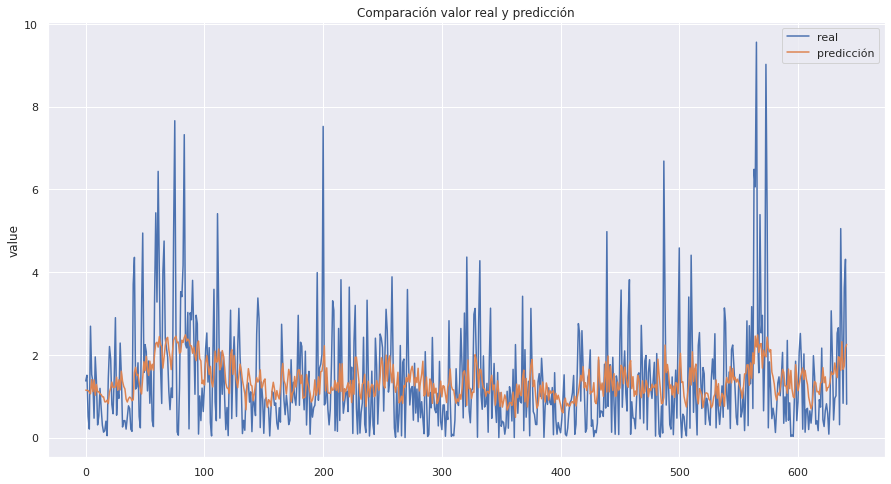

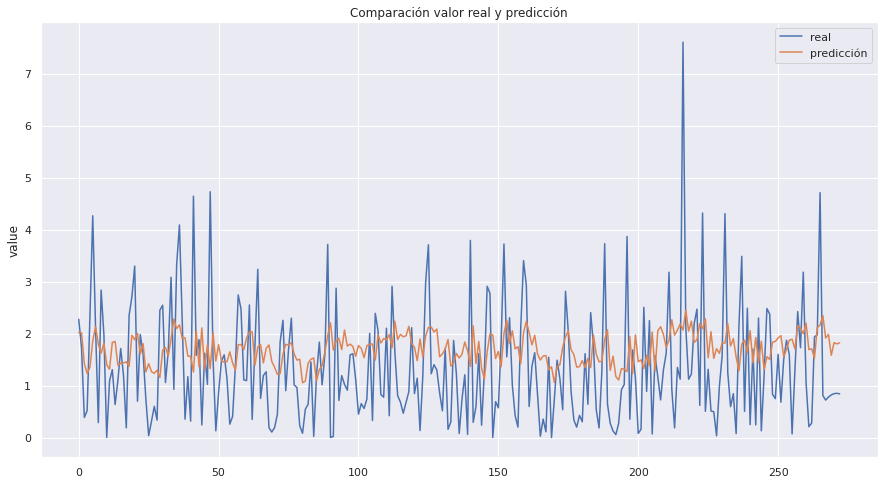

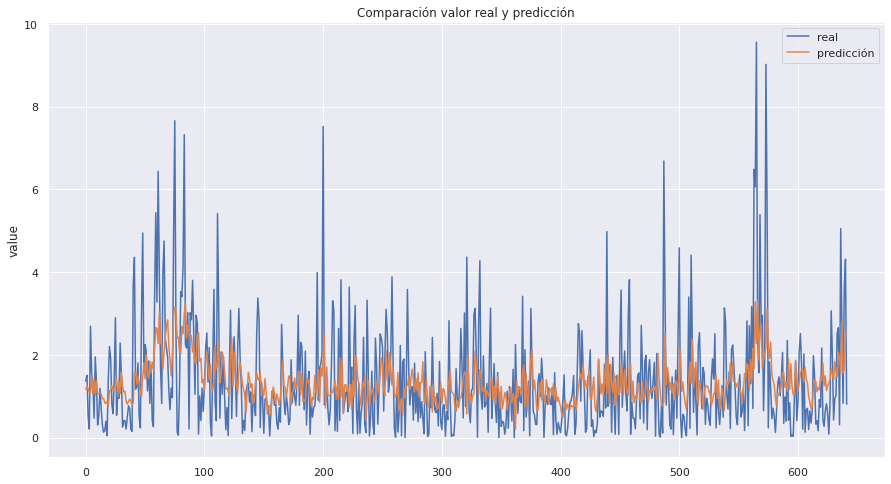

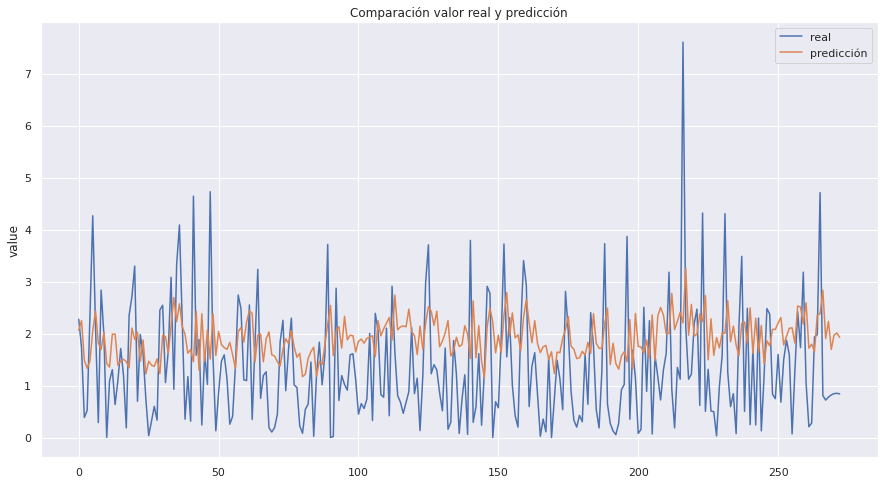

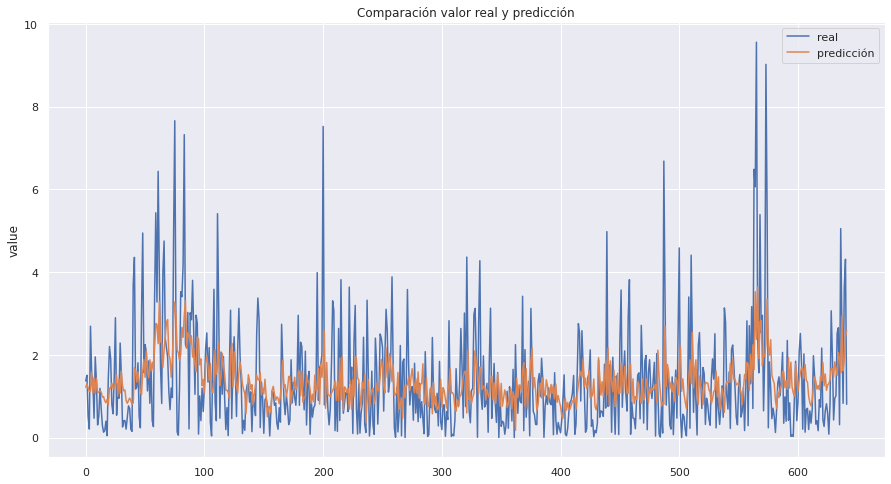

...

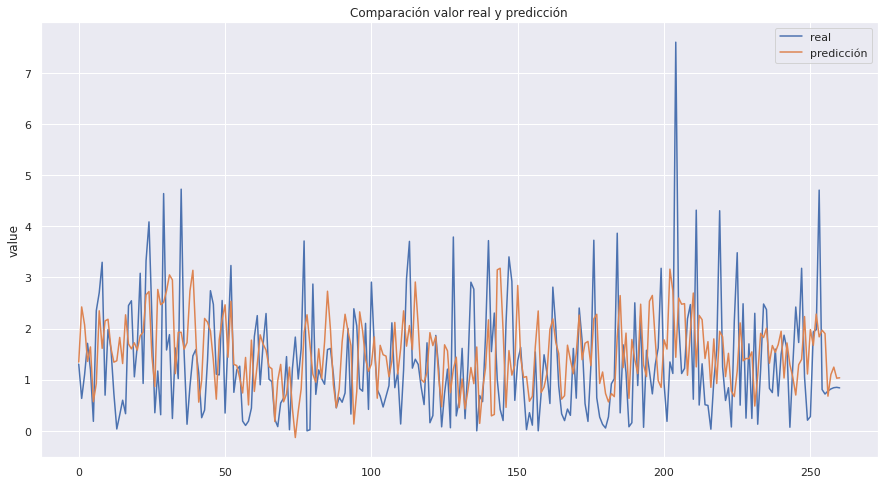

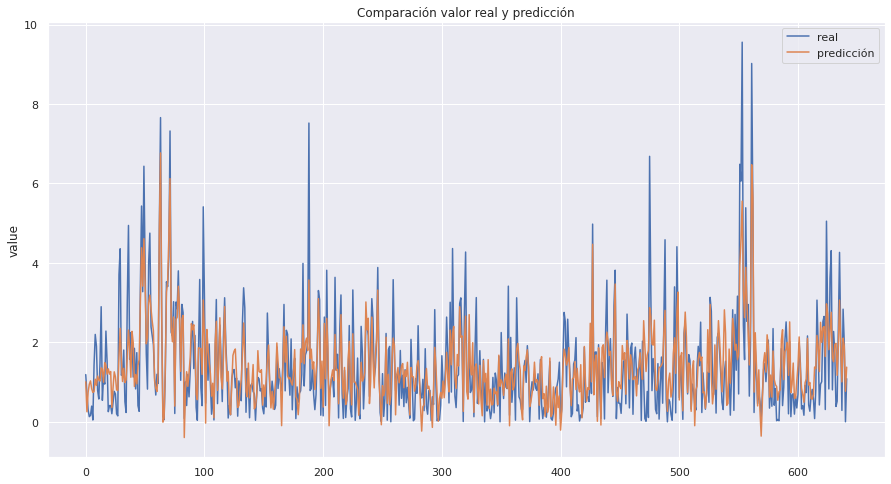

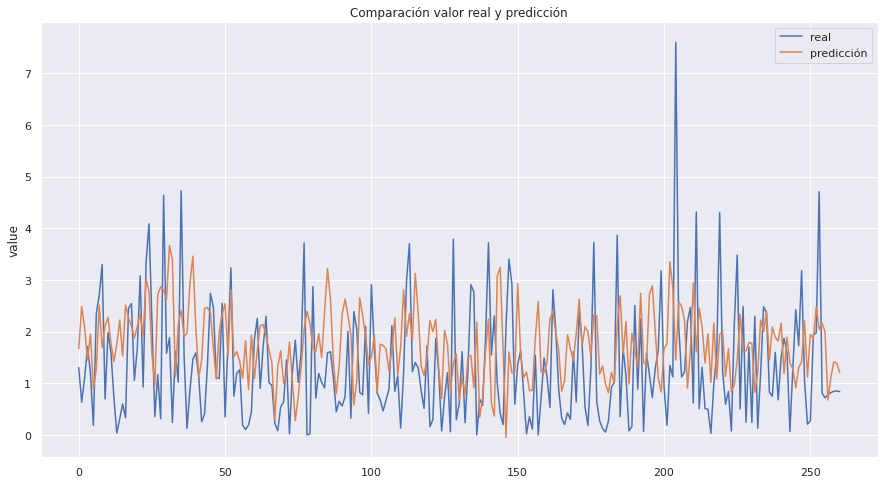

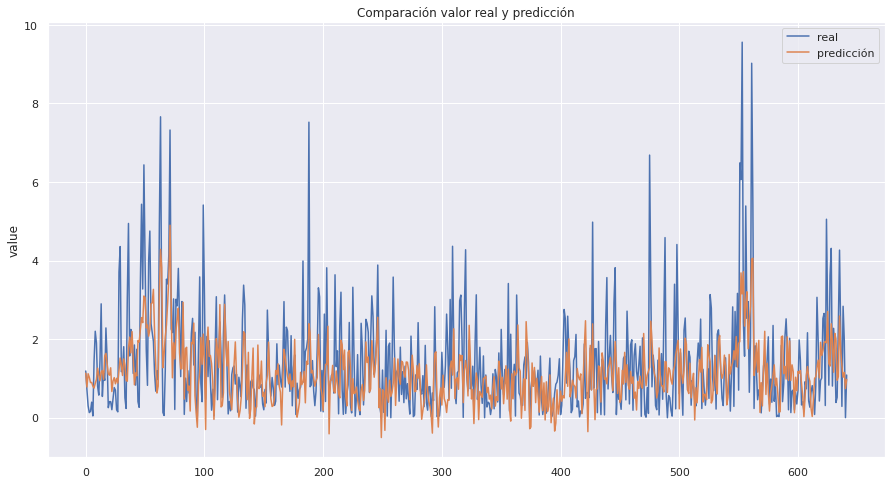

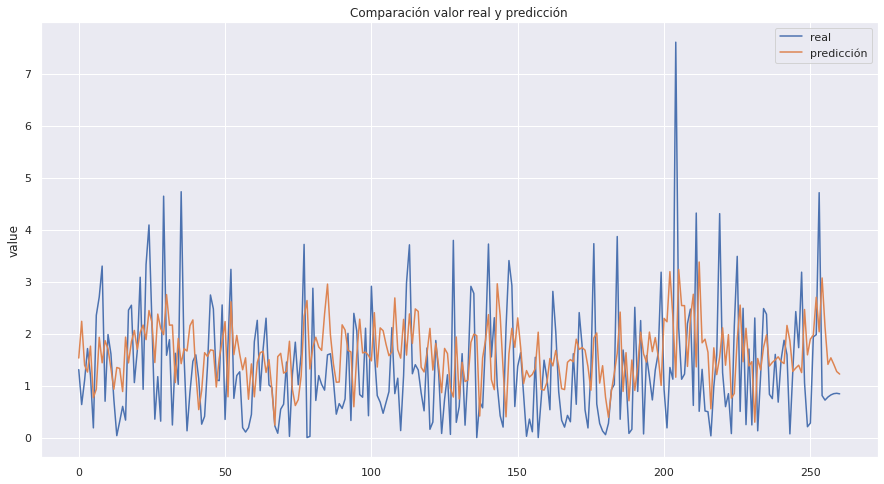

In [11]:
lags=[3,5,7,8,10,15]
n_estimators=[i for i in range(10,100,10)]
n_estimators.extend([200,300,500,2000])
results_models={i:{} for i in lags}
for lg in lags:
    for est in n_estimators:
        results_models[lg][est]=Model(df_data.copy(),df_label.copy(),lg,est)